In [44]:
import os
import sys
from tqdm import tqdm

import h5py
import yaml
import torch
import random
import numpy as np
from ema_pytorch import EMA
import matplotlib.pyplot as plt
from denoising_diffusion_pytorch import Unet, GaussianDiffusion
from torchmetrics.functional.image import (
    peak_signal_noise_ratio,
    structural_similarity_index_measure,
    multiscale_structural_similarity_index_measure
)
from torchmetrics.functional.regression import mean_absolute_error, mean_squared_error
from torchmetrics.functional.classification import dice
sys.path.append('../../tta_uia_segmentation/src/')

from models import ConditionalGaussianDiffusion


In [45]:
def plot_imgs_side_by_side(img_1, img_2, subtitle_1='image_1', subtitle_2='image_2', title=''):
    fig, ax = plt.subplots(1, 2, figsize=(10, 5))
    ax[0].imshow(img_1, cmap='gray')
    ax[0].set_title(subtitle_1)
    ax[1].imshow(img_2, cmap='viridis')
    ax[1].set_title(subtitle_2)
    if title and title.strip() != '':
        plt.suptitle(title)
    plt.show()

In [46]:
metrics_img_to_log_default = {
    'PSNR': peak_signal_noise_ratio,
    'SSIM': structural_similarity_index_measure,
    'MSSIM': multiscale_structural_similarity_index_measure,
    'MAE': mean_absolute_error,
    'MSE': mean_squared_error
}

metrics_seg_log_default = {
    'DICE': dice
}

metrics_to_log_default = {
    'img': metrics_img_to_log_default,
    'seg': metrics_seg_log_default
}

random.seed(1234)
np.random.seed(1234)

# Load the data

### Source Domain

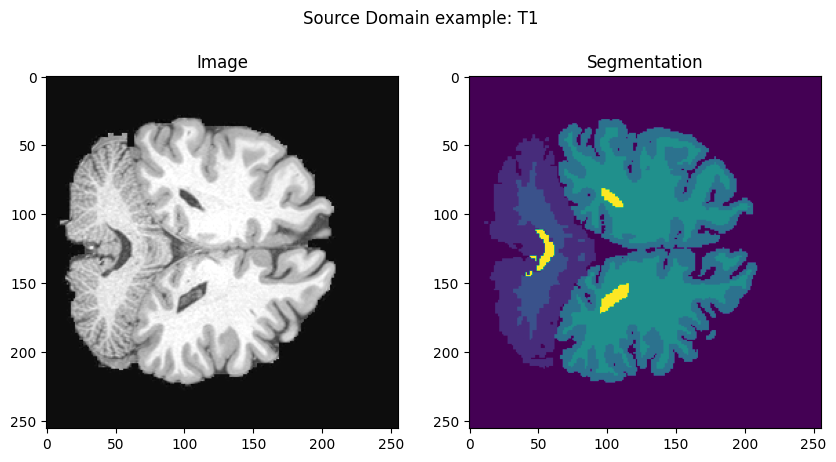

In [47]:
sd_ds_fp = '/scratch_net/biwidl319/jbermeo/logs/brain/preprocessing/hcp_t1/data_T1_2d_size_256_256_depth_256_res_0.7_0.7_from_0_to_20.hdf_normalized_with_nn.h5'
sd_ds_h5 = h5py.File(sd_ds_fp, 'r')

img_size = 256
n_classes = 15
vol_idx = random.randint(0, int(sd_ds_h5['images'].shape[0]/img_size))
slice_idx = random.randint(int(0.2 * img_size), int(0.8 * img_size))
rand_img_sd = sd_ds_h5['images'][vol_idx * img_size + slice_idx, :, :]
seg_sd = sd_ds_h5['labels'][vol_idx * img_size + slice_idx, :, :]

plot_imgs_side_by_side(rand_img_sd, seg_sd, subtitle_1='Image', subtitle_2='Segmentation', title='Source Domain example: T1')

### Target Domain

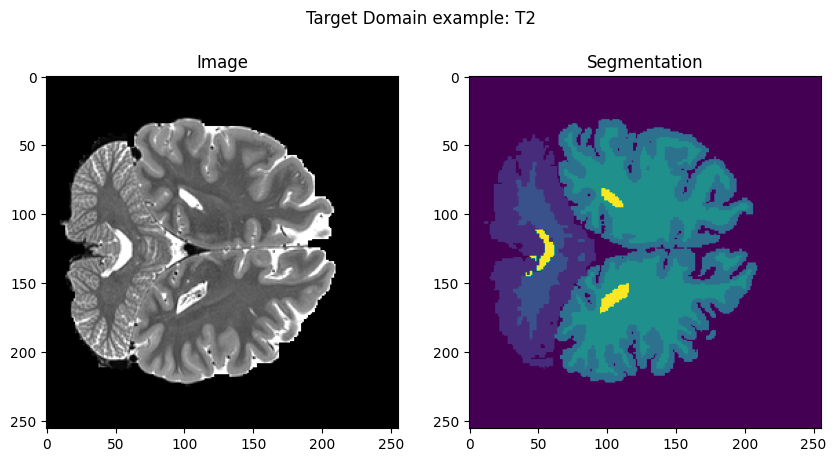

In [48]:
td_ds_fp = '/scratch_net/biwidl319/jbermeo/data/previous_results_nico/datasets/data_T2_2d_size_256_256_depth_256_res_0.7_0.7_from_0_to_20.hdf5'
td_ds_h5 = h5py.File(td_ds_fp, 'r')

rand_img_td = td_ds_h5['images'][vol_idx * img_size + slice_idx, :, :]
seg_td = td_ds_h5['labels'][vol_idx * img_size + slice_idx, :, :]

assert (seg_td == seg_sd).all(), 'The segmentations are different'

plot_imgs_side_by_side(rand_img_td, seg_td, subtitle_1='Image', subtitle_2='Segmentation', title='Target Domain example: T2')

# Check how the denoising is working with the joint denoising model

### Load the checkpointed model

In [49]:
run_params = yaml.safe_load(
    open('/scratch_net/biwidl319/jbermeo/logs/brain/ddpm/hcp_t1/params.yaml', 'r'))

train_config = run_params['training']['ddpm']

# Model definition
model = Unet(
    dim = 64,
    dim_mults = (1, 2, 4, 8),   
    flash_attn = True,
    channels=2, 
    self_condition=False,
)#.to(device)

ddpm = GaussianDiffusion(
    model,
    image_size = 256,
    timesteps = 1000,    # Range of steps in diffusion process
    sampling_timesteps = 100 
)

# Define EMA version of the model
ema_update_every = 10
ema_decay = 0.995
ddpm_ema = EMA(ddpm, beta = ema_decay, update_every = ema_update_every)

In [50]:
cpt_path = '/scratch_net/biwidl319/jbermeo/logs/brain/ddpm/hcp_t1/model-10.pt'
cpt = torch.load(cpt_path, map_location='cpu')

ema_update_every = 10
ema_decay = 0.995
ddpm_ema = EMA(ddpm, beta = ema_decay, update_every = ema_update_every)
ddpm_ema.load_state_dict(cpt['ema'])

<All keys matched successfully>

## Check denoising on the source domain 

In [51]:
def evaluate_denoising(
    img: torch.Tensor,
    seg: torch.Tensor,
    n_classes: int,
    t: int,
    ddpm: GaussianDiffusion,
    plot_every: int = 50,
    metrics: dict = metrics_to_log_default
    ) -> dict[str, dict]:
    
    # Normalize segmentation
    seg = seg / (n_classes - 1)
    seg_norm = ddpm.normalize(seg)
    
    # Normalize image between -1 and 1
    img_norm = ddpm.normalize(img)
    
    # Concatenate image and segmentation along z-axis
    img_seg = torch.cat([img_norm.unsqueeze(0), seg_norm.unsqueeze(0)], dim=0)
    img_seg = img_seg.unsqueeze(0)
    t_tch = torch.full((1,), t)
    
    # Create noised image
    noise = torch.randn_like(img_seg)
    noised_img = ddpm.q_sample(img_seg, t_tch, noise)
    
    plot_imgs_side_by_side(img_norm, seg_norm, subtitle_1='Image', subtitle_2='Segmentation', title='Original')
    plot_imgs_side_by_side(noised_img[0,0,:,:].detach().numpy(), noised_img[0,1,:,:].detach().numpy(),
                           subtitle_1='Image', subtitle_2='Segmentation', title=f'Noised at {t}')
    
    # Do linear sampling denoising
    denoised_img = noised_img
    metrics_img_log = {k: list() for k in metrics['img'].keys()}
    metrics_seg_log = {k: list() for k in metrics['seg'].keys()}
    
    for t_i in tqdm(reversed(range(0, t)), desc = 'sampling loop time step', total = t):
        denoised_img, x_start = ddpm.p_sample(denoised_img, t_i)
        
        if t_i % plot_every == 0 or t_i == 0:
            plot_imgs_side_by_side(denoised_img[0,0,:,:].detach().numpy(), denoised_img[0,1,:,:].detach().numpy(), subtitle_1='Image', subtitle_2='Segmentation',
                           title=f'Denoised, t: {t_i}')
            
            plot_imgs_side_by_side(x_start[0,0,:,:].detach().numpy(), x_start[0,1,:,:].detach().numpy(), subtitle_1='Image', subtitle_2='Segmentation',
                           title=f'Denoised estimate of t=0 @ t: {t_i}')
            
        for metric_name, metric_log in metrics_img_log.items():
            denoised_img_metric_ti = metrics['img'][metric_name](img_norm[None, None, ...], denoised_img[:, 0:1,...]).item()
            denoised_img_metric_t0 = metrics['img'][metric_name](img_norm[None, None, ...], x_start[:, 0:1,...]).item()
            metric_log.append(
                (t - t_i, denoised_img_metric_ti, denoised_img_metric_t0)
            )

            # for metric_name, metric_log in metrics_seg_log.items():
            #     metric_log.append(
            #         (t_i, metrics['seg'][metric_name](
            #             (ddpm.unnormalize(seg[None, None, ...]) * (n_classes - 1)).int(),
            #             (ddpm.unnormalize(denoised_img[:, 0:1,...]) * (n_classes - 1)).int()
            #             )
            #         )
            #     )
    
    return {'img': metrics_img_log, 'seg': metrics_seg_log}

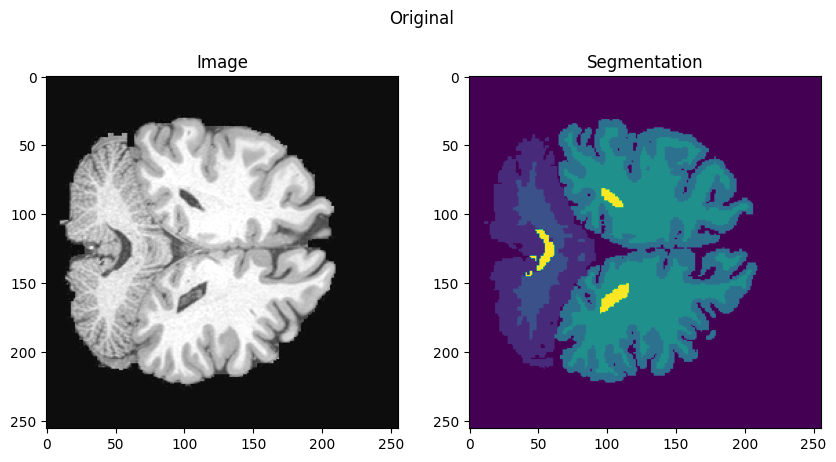

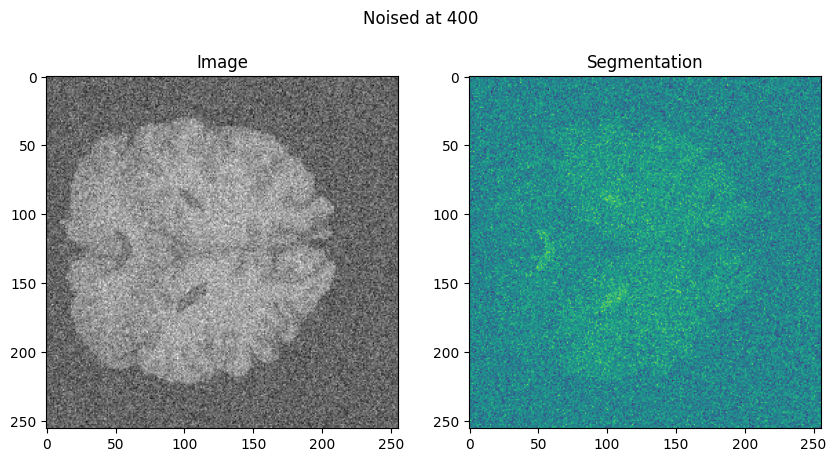

sampling loop time step:   3%|▎         | 12/400 [00:08<04:26,  1.45it/s]

sampling loop time step:   6%|▌         | 24/400 [00:17<04:10,  1.50it/s]

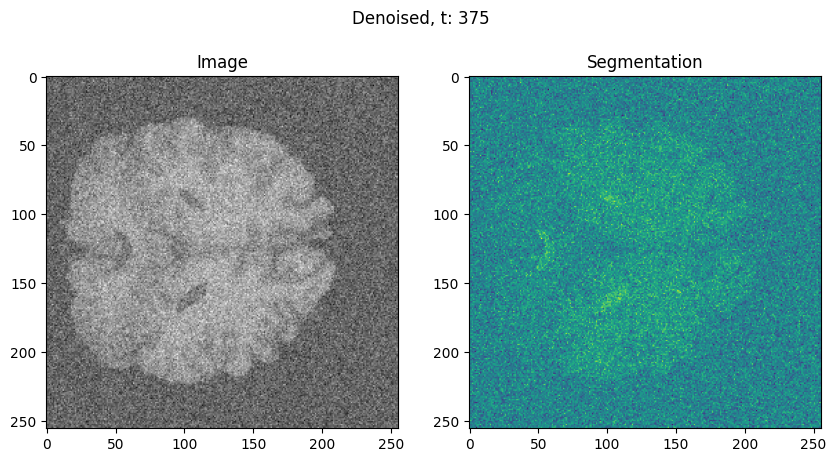

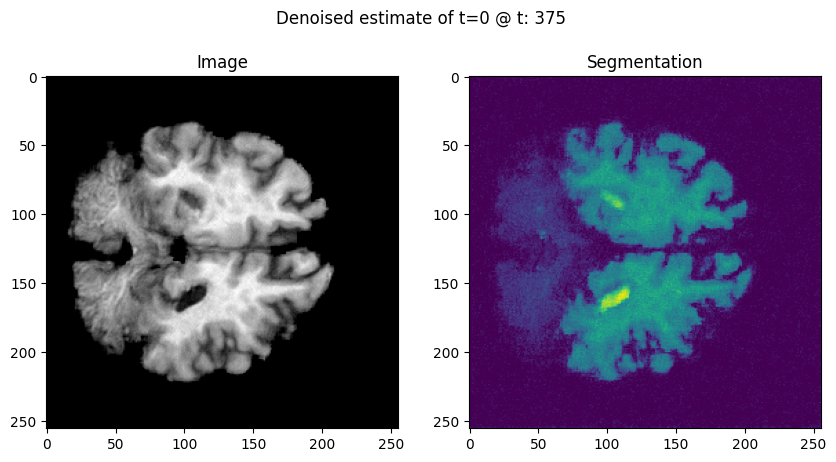

sampling loop time step:  12%|█▏        | 49/400 [00:48<08:00,  1.37s/it]

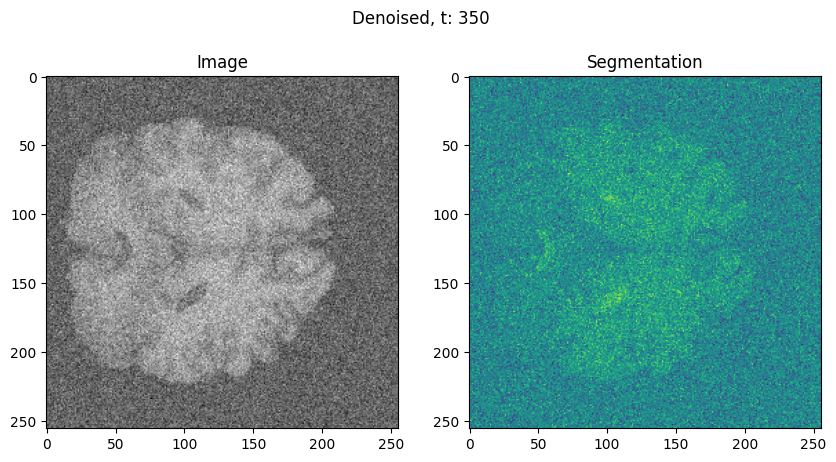

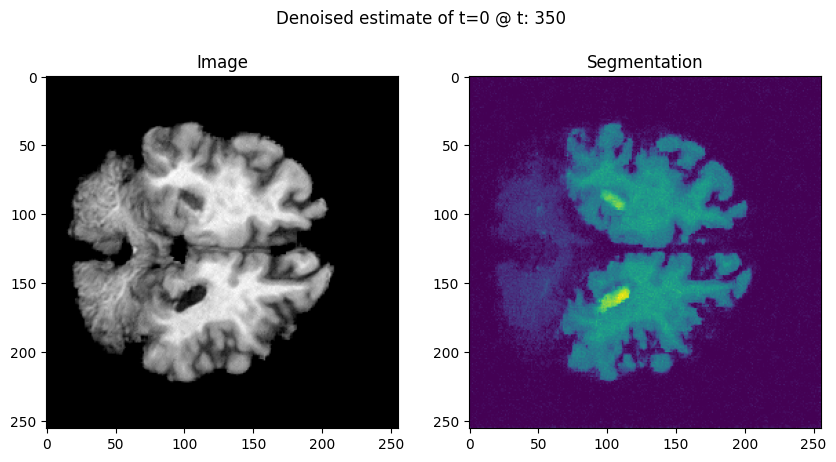

sampling loop time step:  18%|█▊        | 74/400 [01:14<06:19,  1.16s/it]

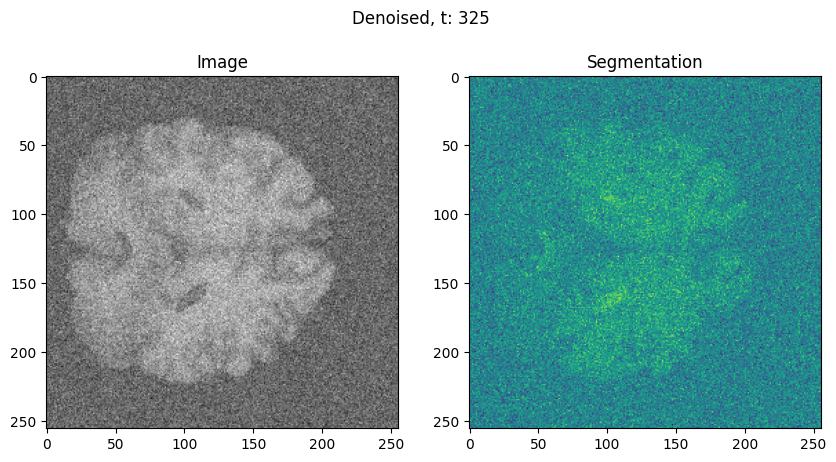

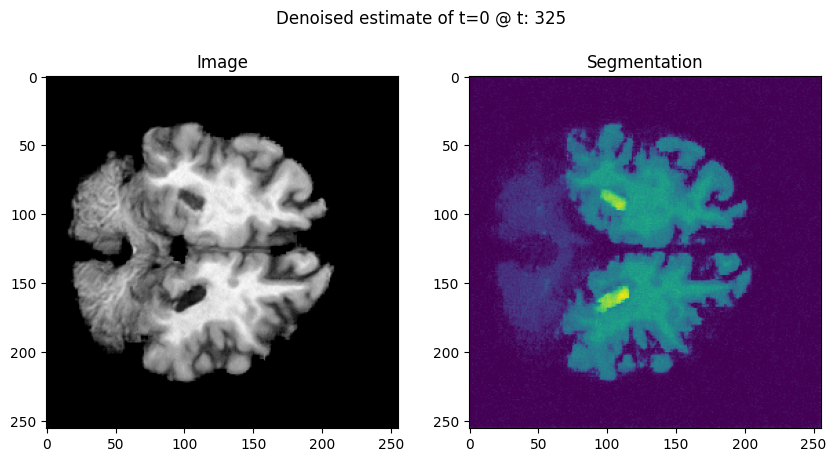

sampling loop time step:  25%|██▍       | 99/400 [01:40<04:04,  1.23it/s]

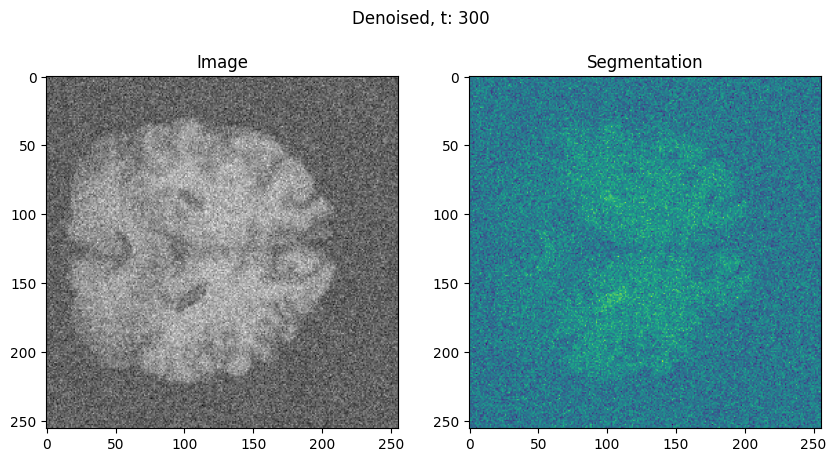

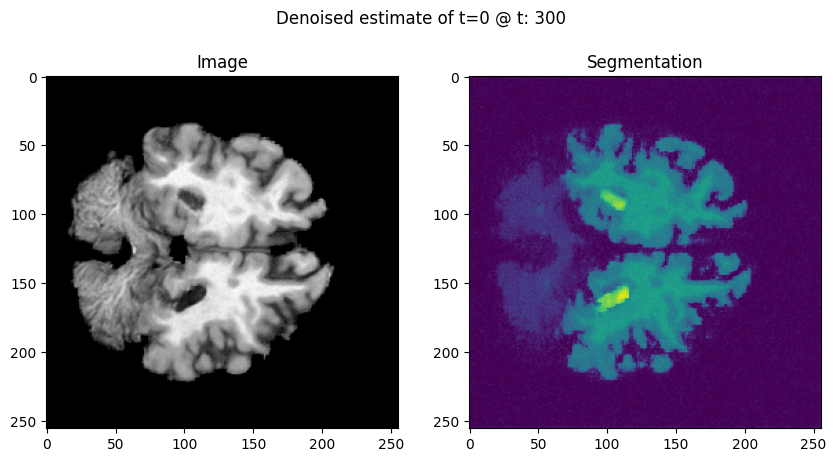

sampling loop time step:  31%|███       | 124/400 [02:04<03:29,  1.32it/s]

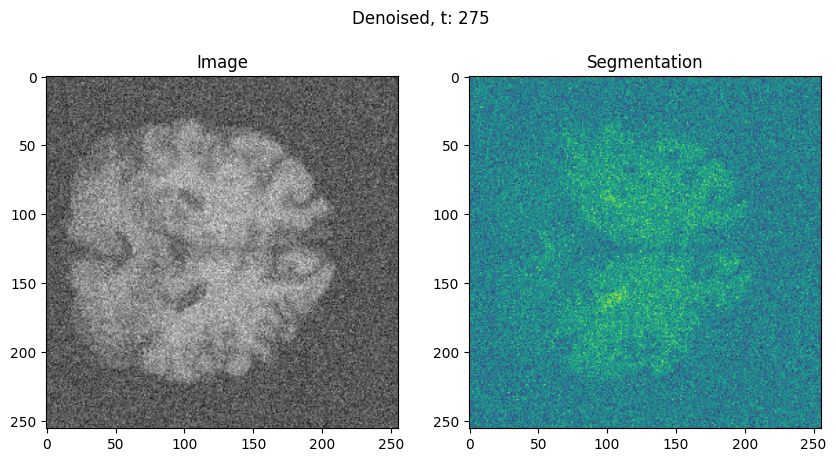

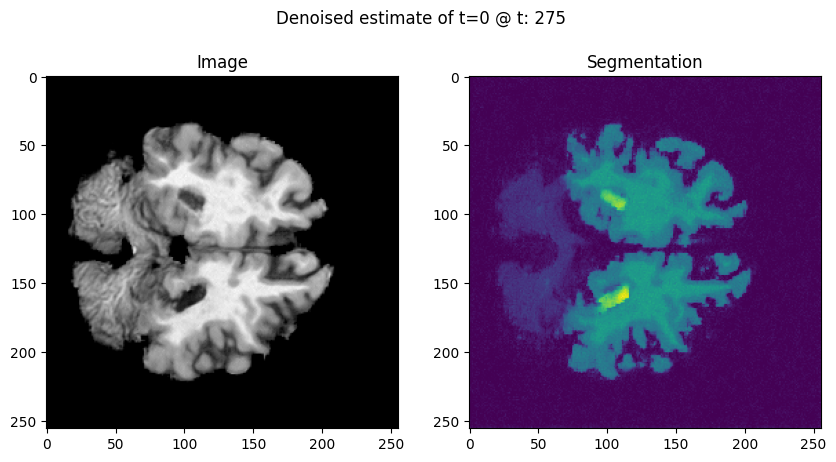

sampling loop time step:  37%|███▋      | 149/400 [02:26<03:53,  1.07it/s]

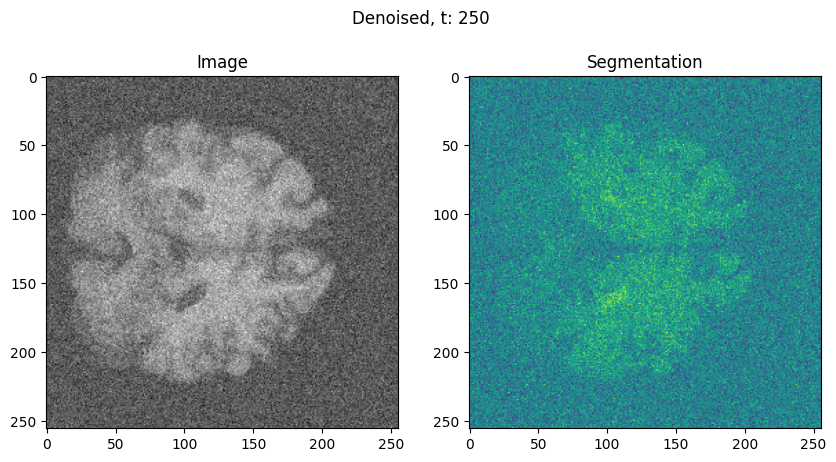

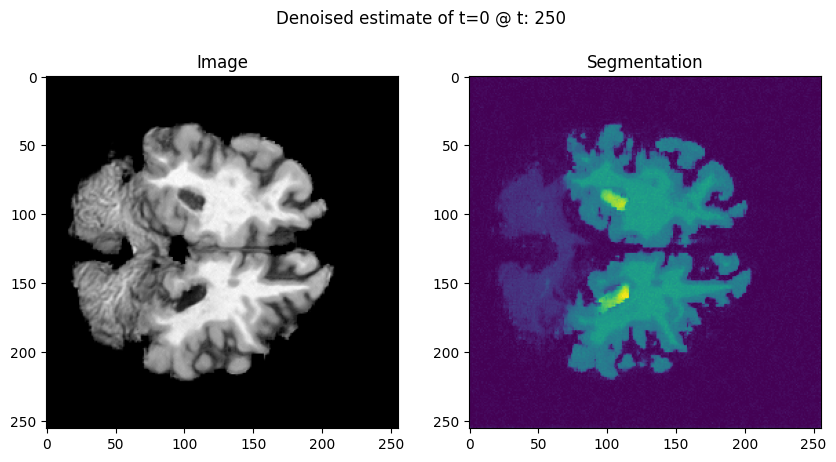

sampling loop time step:  44%|████▎     | 174/400 [02:52<03:43,  1.01it/s]

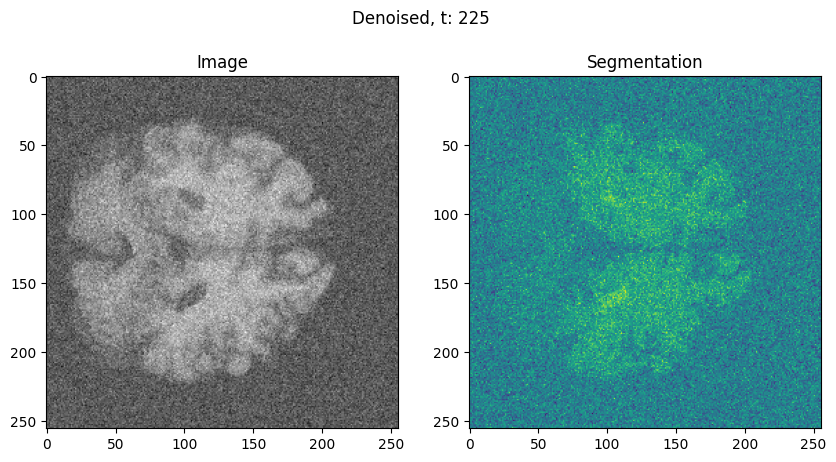

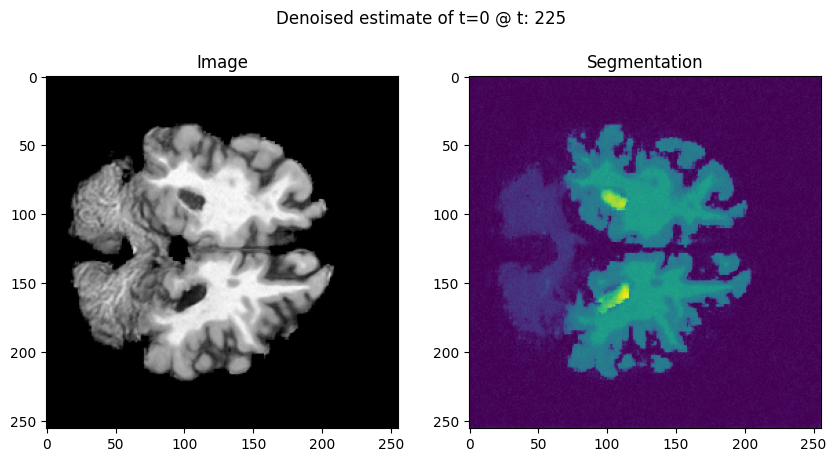

sampling loop time step:  50%|████▉     | 199/400 [03:16<02:42,  1.24it/s]

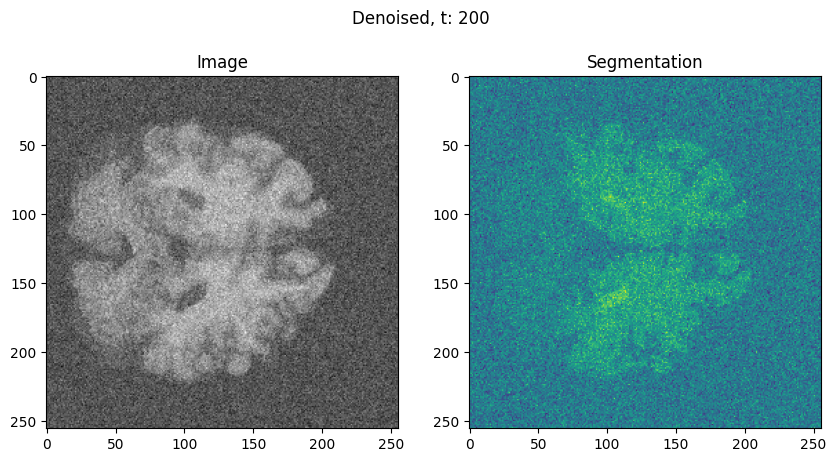

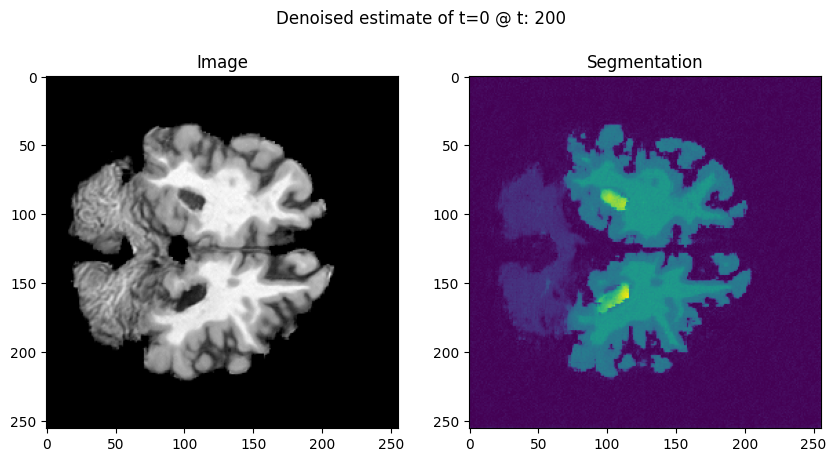

sampling loop time step:  56%|█████▌    | 224/400 [03:41<02:34,  1.14it/s]

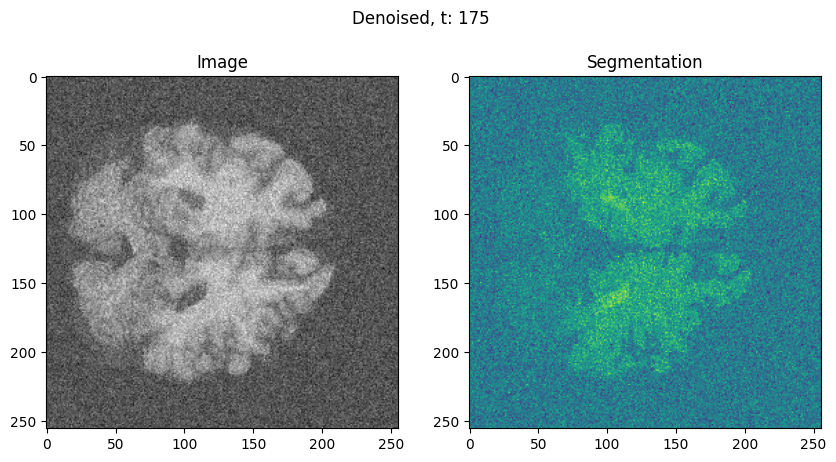

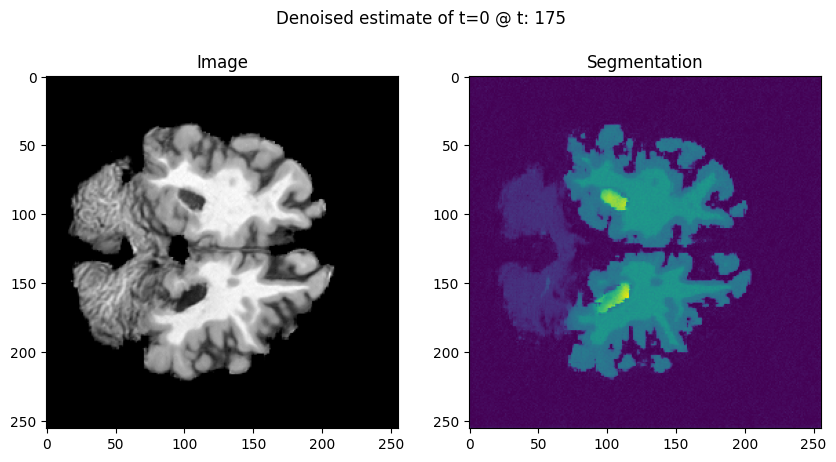

sampling loop time step:  62%|██████▏   | 249/400 [04:03<01:53,  1.33it/s]

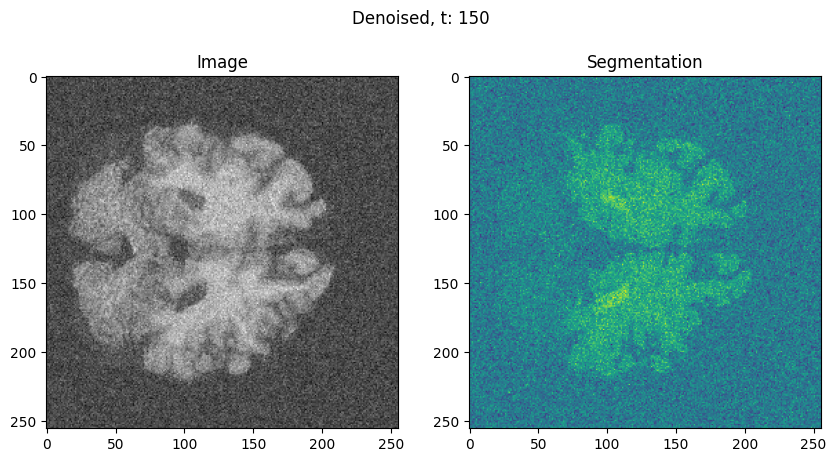

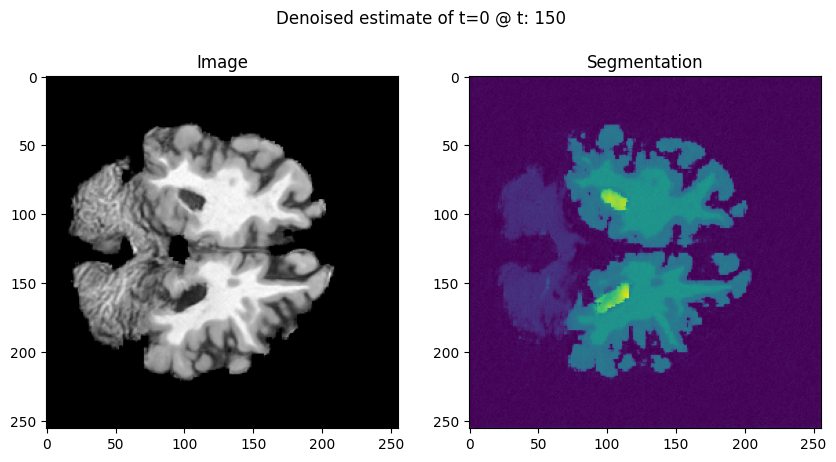

sampling loop time step:  68%|██████▊   | 274/400 [04:24<01:31,  1.37it/s]

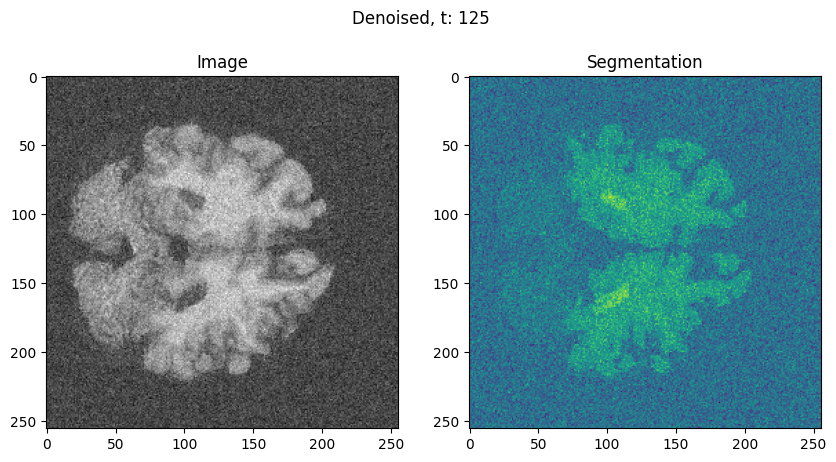

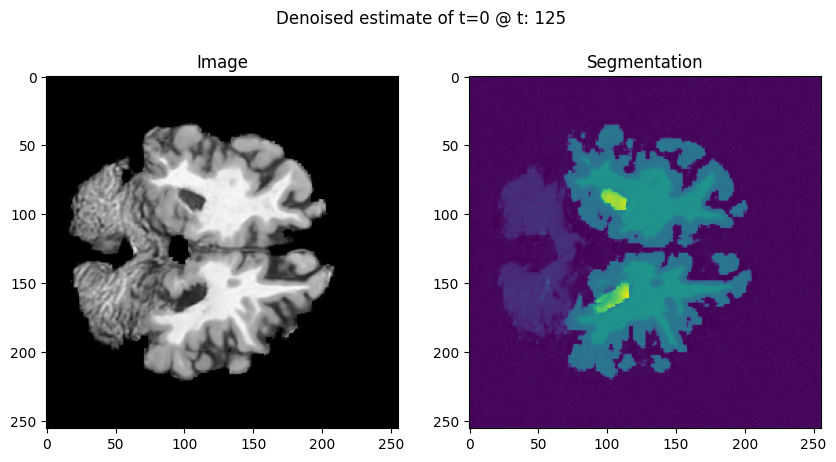

sampling loop time step:  75%|███████▍  | 299/400 [04:47<01:15,  1.34it/s]

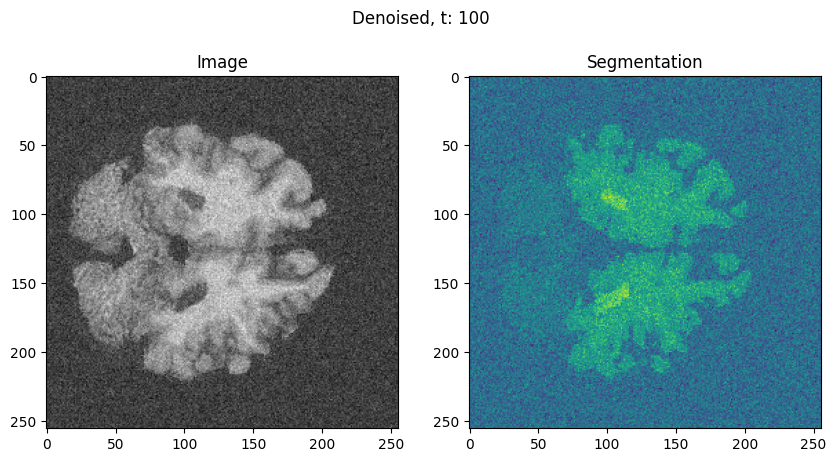

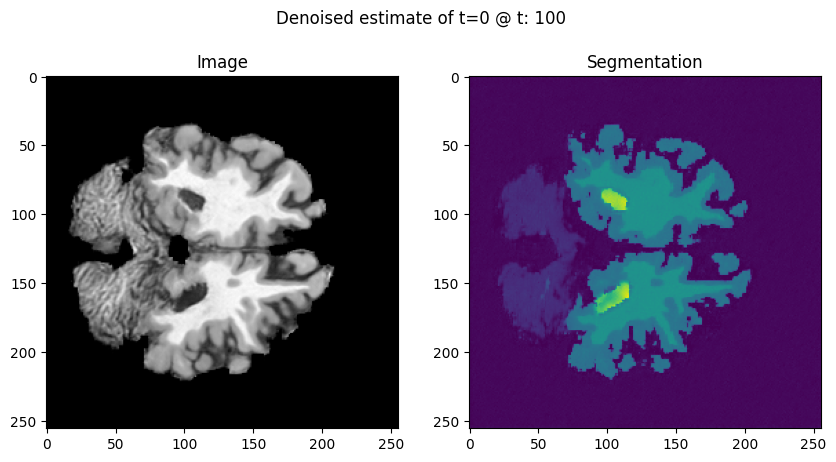

sampling loop time step:  81%|████████  | 324/400 [05:09<00:59,  1.27it/s]

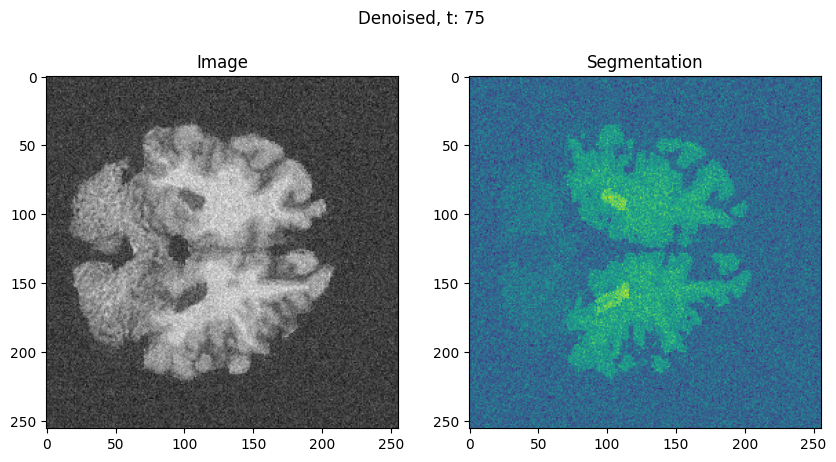

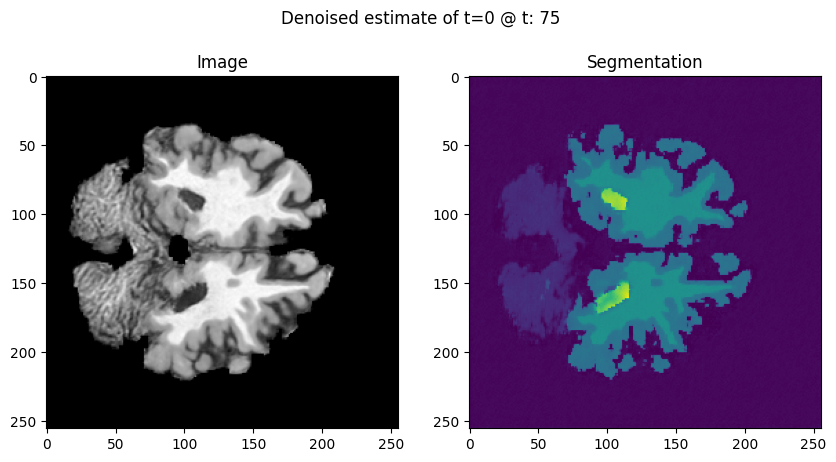

sampling loop time step:  87%|████████▋ | 349/400 [05:31<00:37,  1.34it/s]

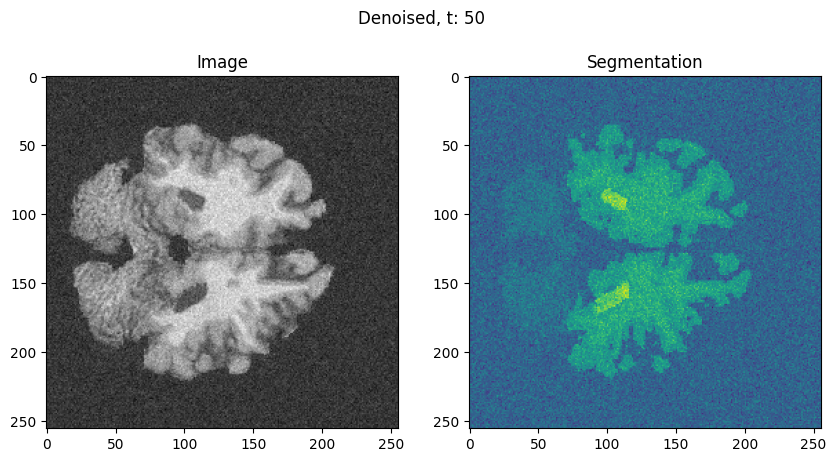

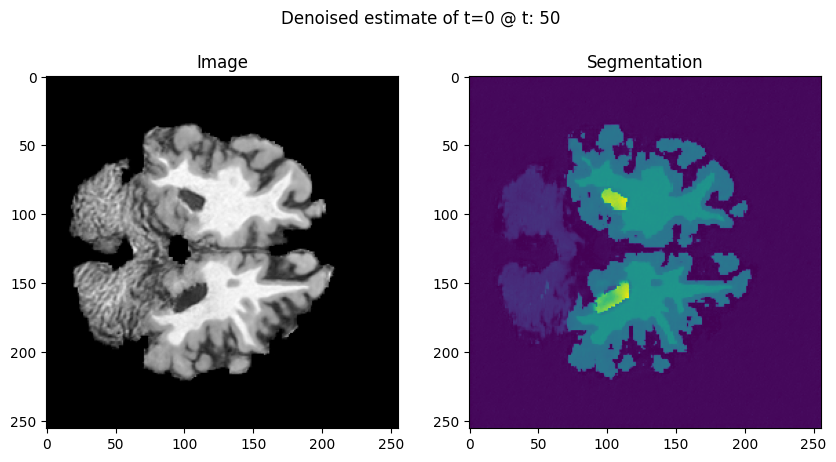

sampling loop time step:  94%|█████████▎| 374/400 [05:51<00:20,  1.27it/s]

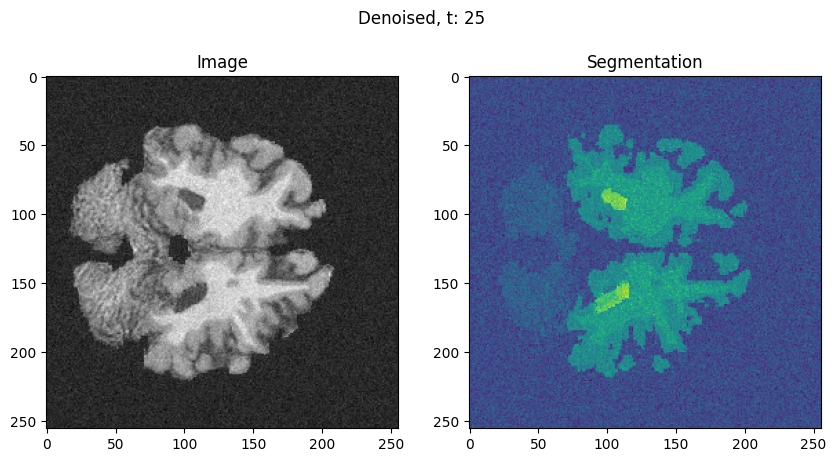

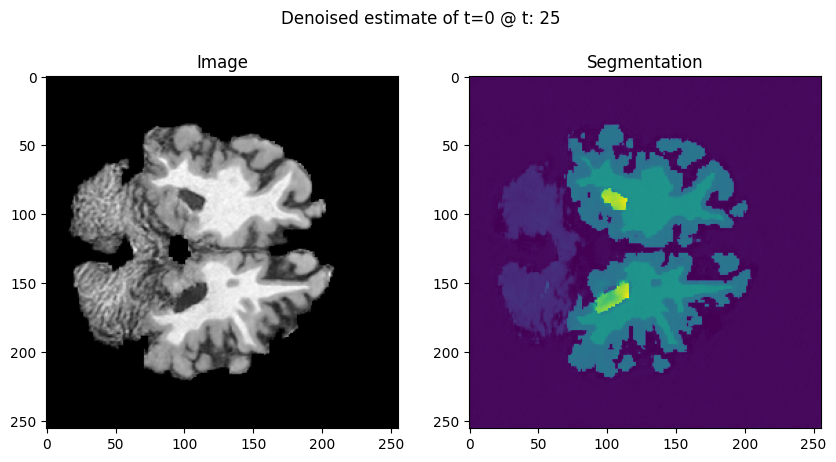

sampling loop time step: 100%|█████████▉| 399/400 [06:17<00:00,  1.23it/s]

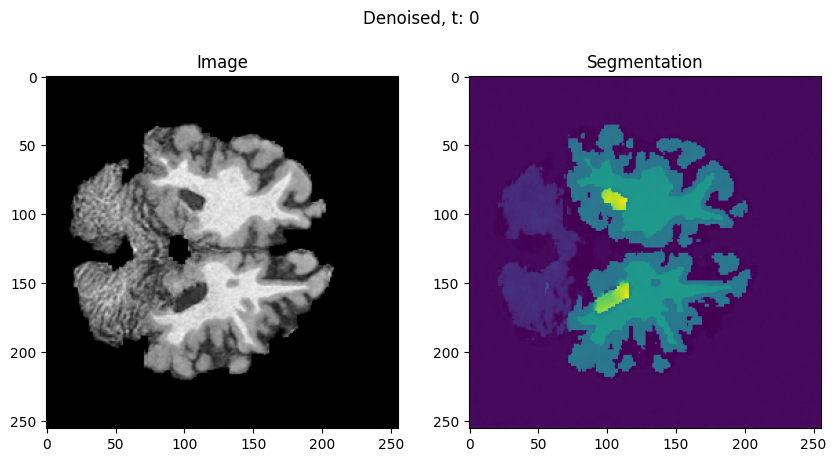

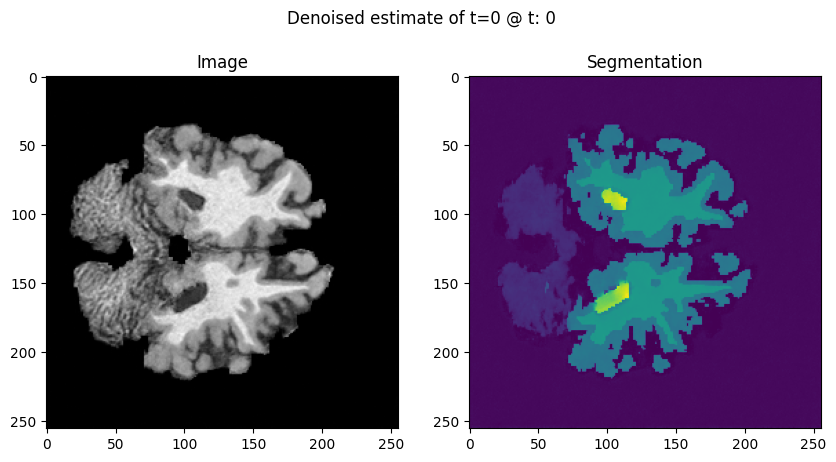

sampling loop time step: 100%|██████████| 400/400 [06:18<00:00,  1.06it/s]


In [52]:
metrics = evaluate_denoising(
    img=torch.from_numpy(rand_img_sd),
    seg=torch.from_numpy(seg_sd),
    n_classes=n_classes,
    t=400,
    ddpm=ddpm_ema.model,
    plot_every=25,
    metrics=metrics_to_log_default
    )

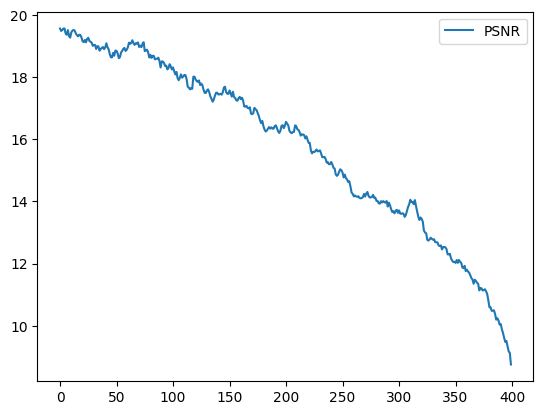

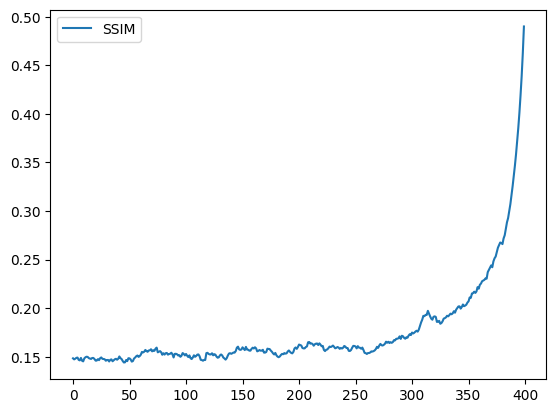

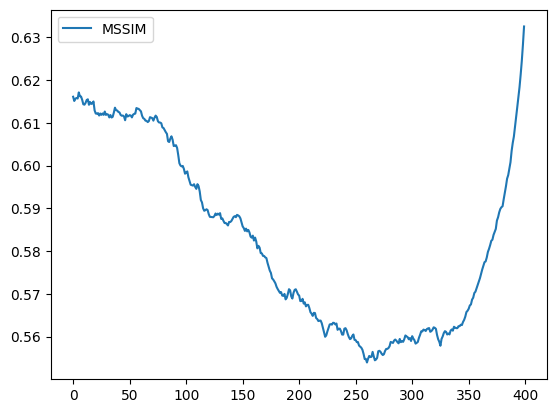

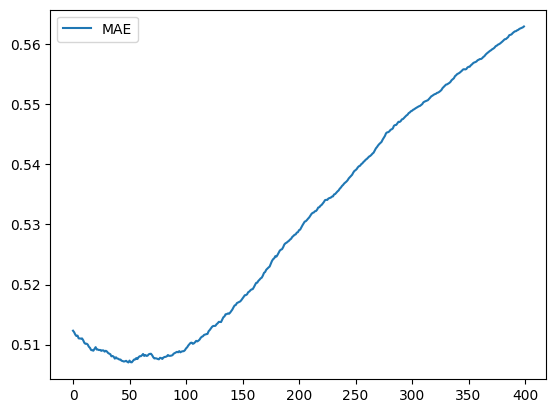

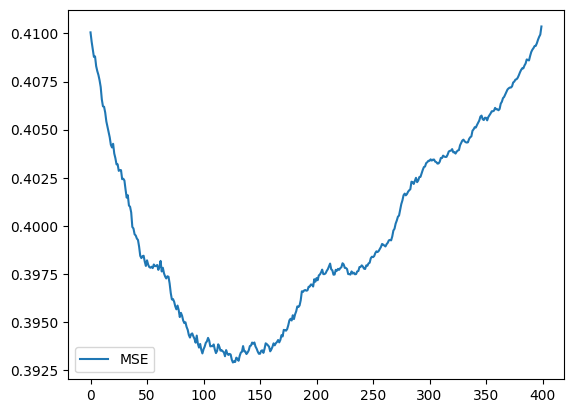

In [53]:
for metric_name, metric_log in metrics['img'].items():
    plt.plot(np.array(metric_log)[:, 1], label=metric_name)
    plt.legend()
    plt.show()

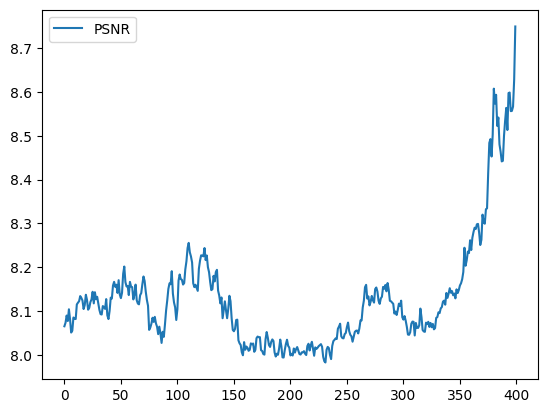

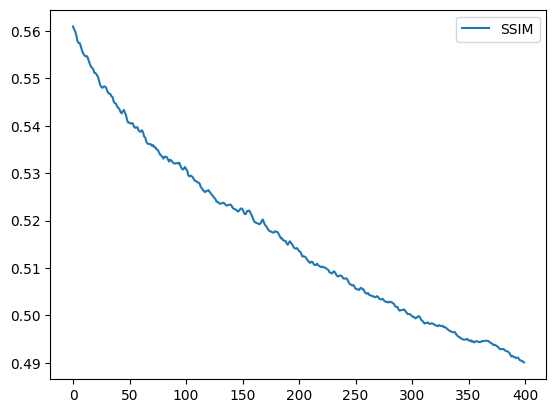

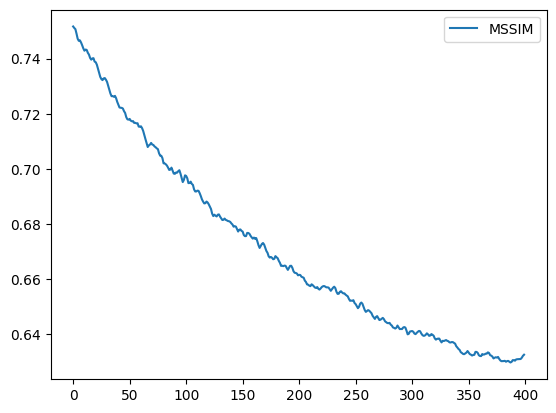

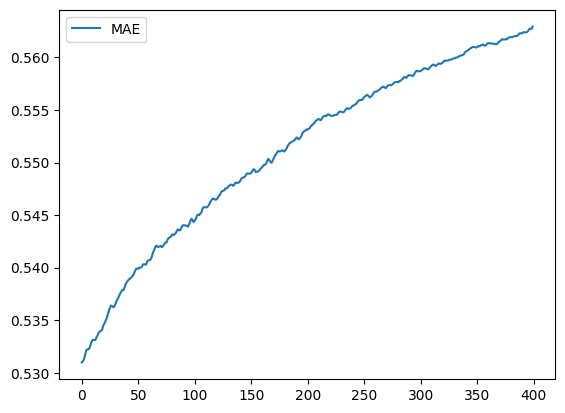

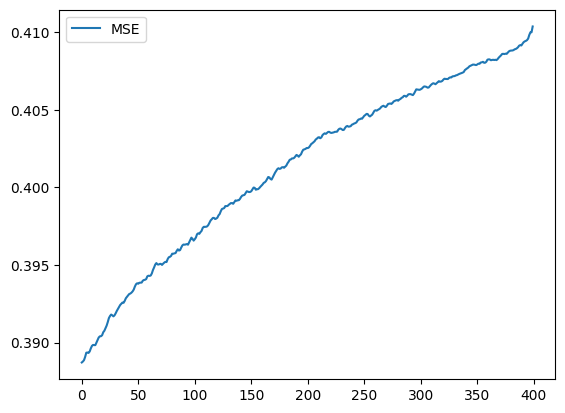

In [54]:
for metric_name, metric_log in metrics['img'].items():
    plt.plot(np.array(metric_log)[:, 2], label=metric_name)
    plt.legend()
    plt.show()

## Check denoising on the target domain

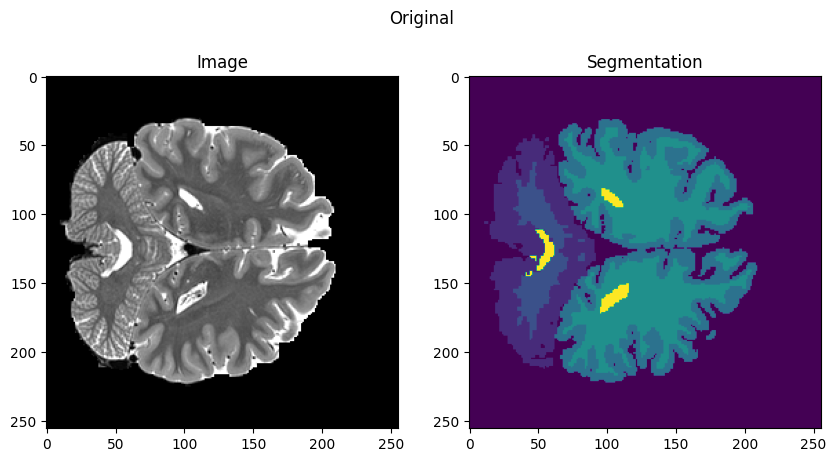

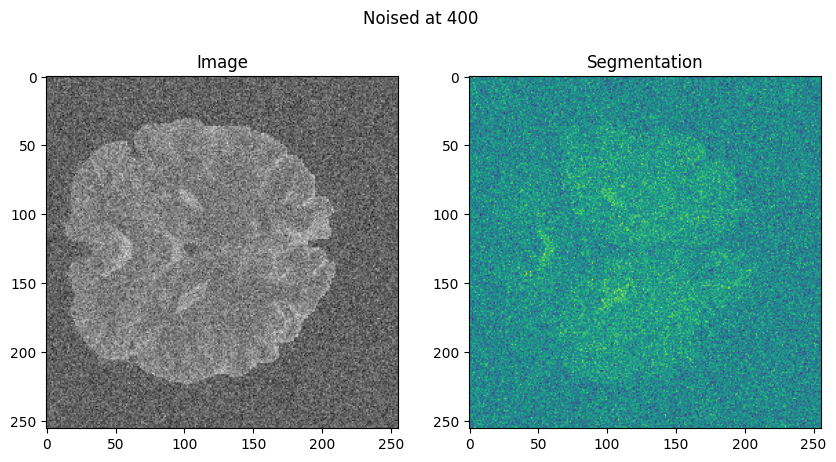

sampling loop time step:   6%|▌         | 24/400 [00:21<06:09,  1.02it/s]

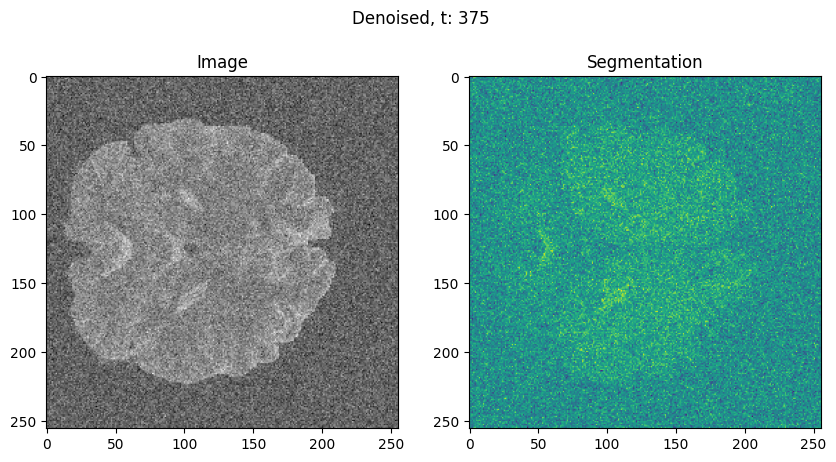

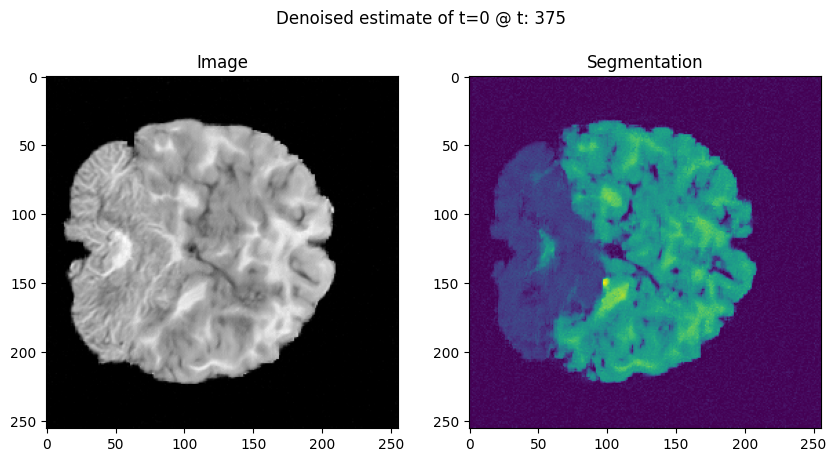

sampling loop time step:  12%|█▏        | 49/400 [00:44<04:47,  1.22it/s]

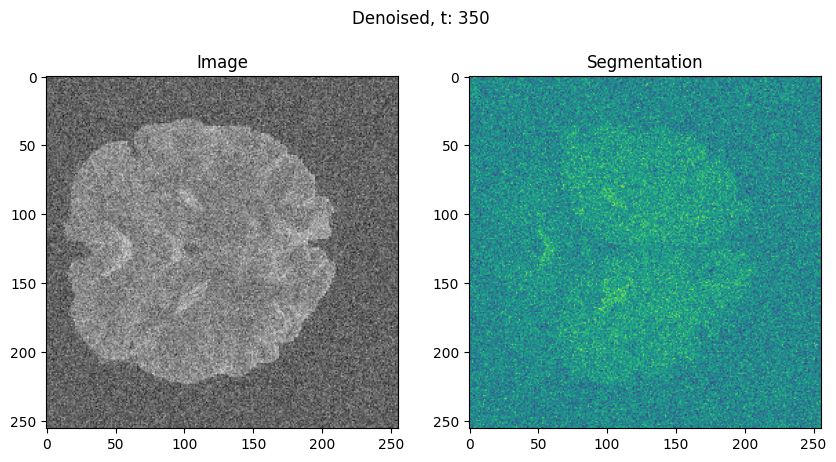

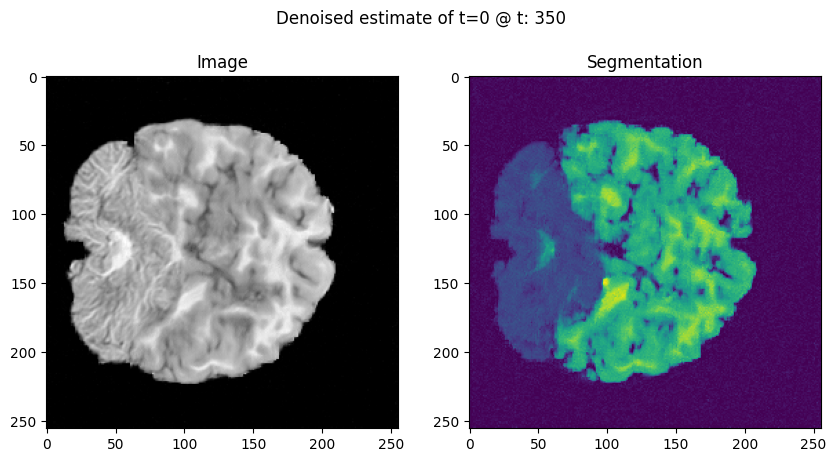

sampling loop time step:  18%|█▊        | 74/400 [01:03<03:45,  1.45it/s]

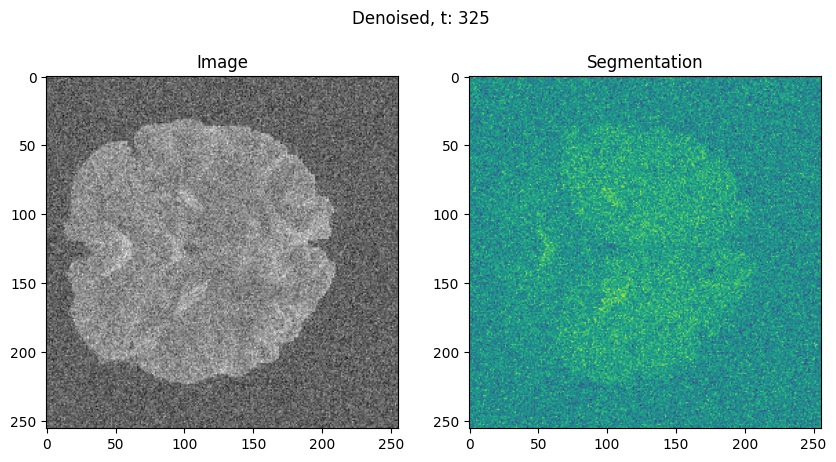

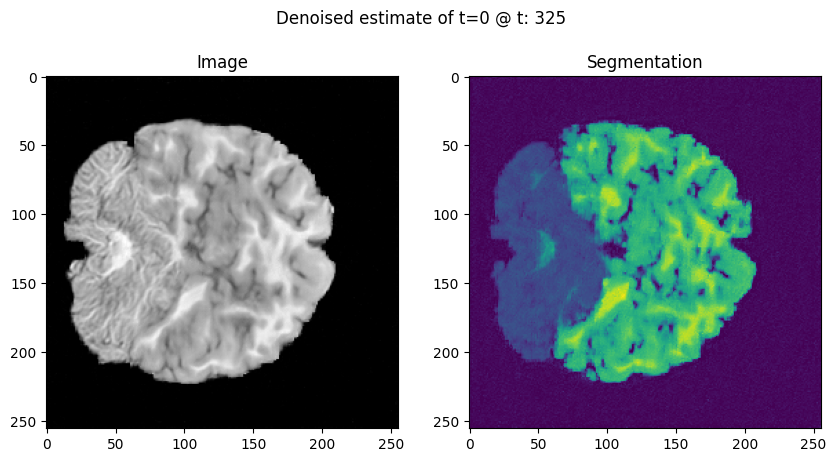

sampling loop time step:  25%|██▍       | 99/400 [01:26<04:41,  1.07it/s]

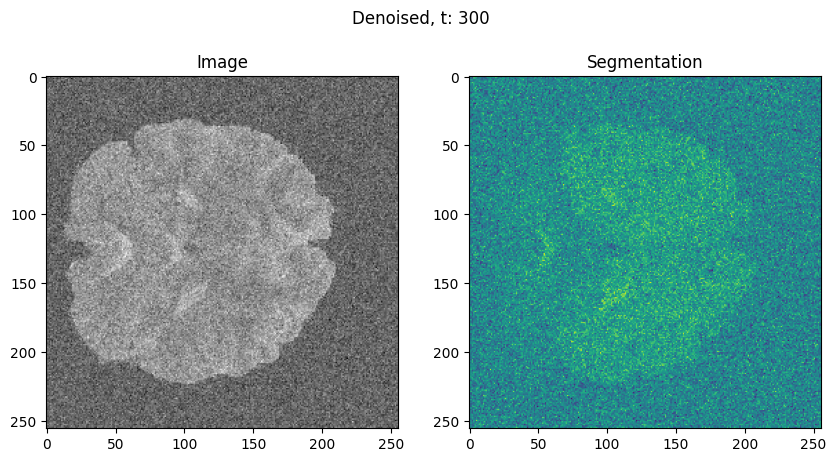

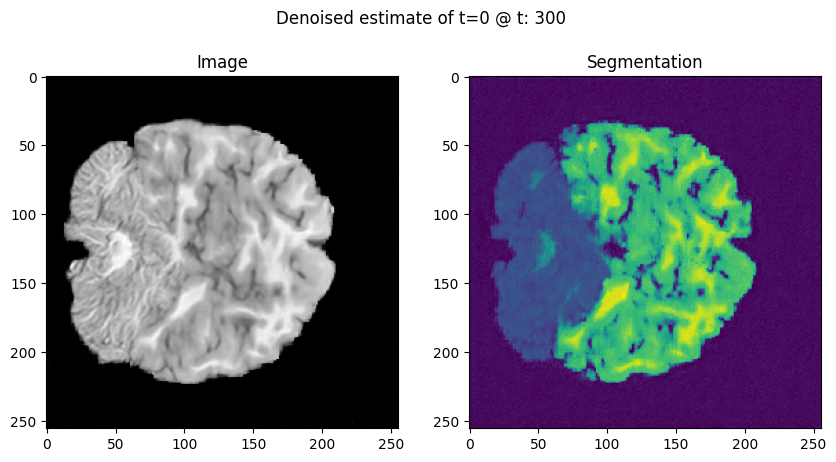

sampling loop time step:  31%|███       | 124/400 [01:49<04:27,  1.03it/s]

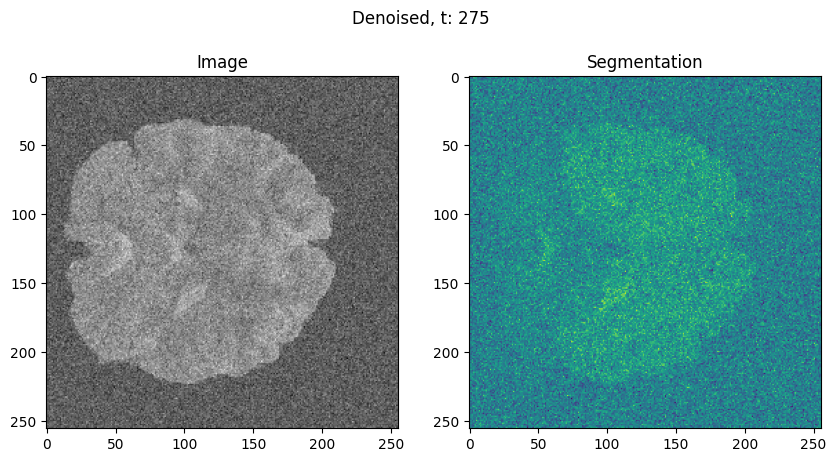

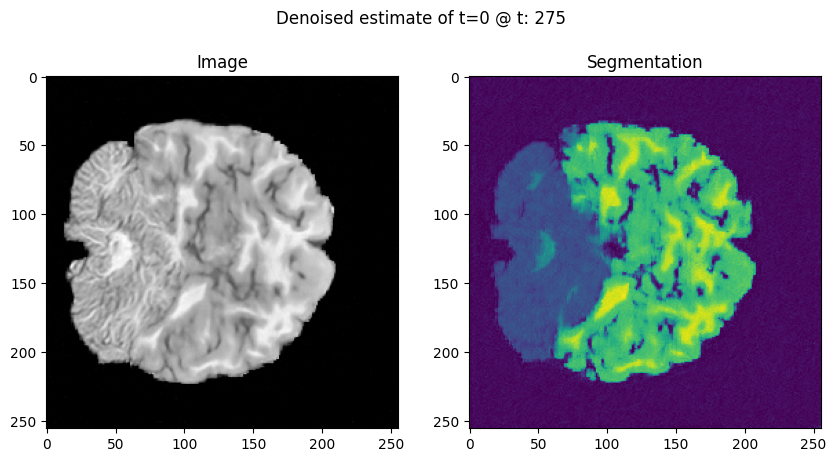

sampling loop time step:  37%|███▋      | 149/400 [02:13<03:33,  1.18it/s]

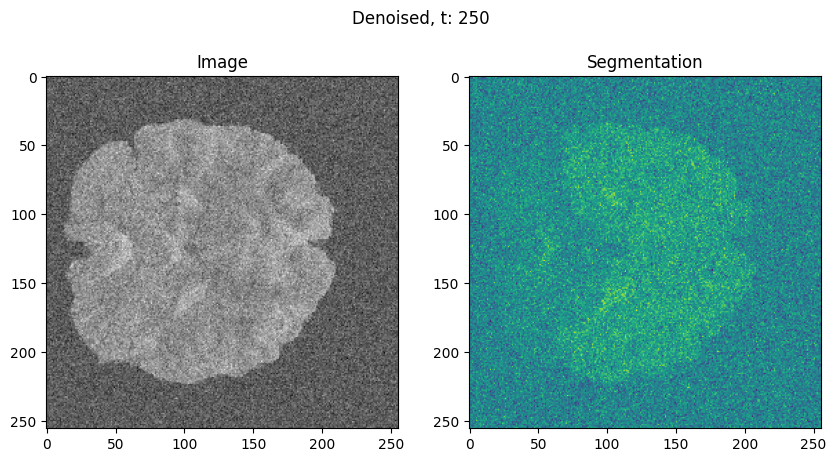

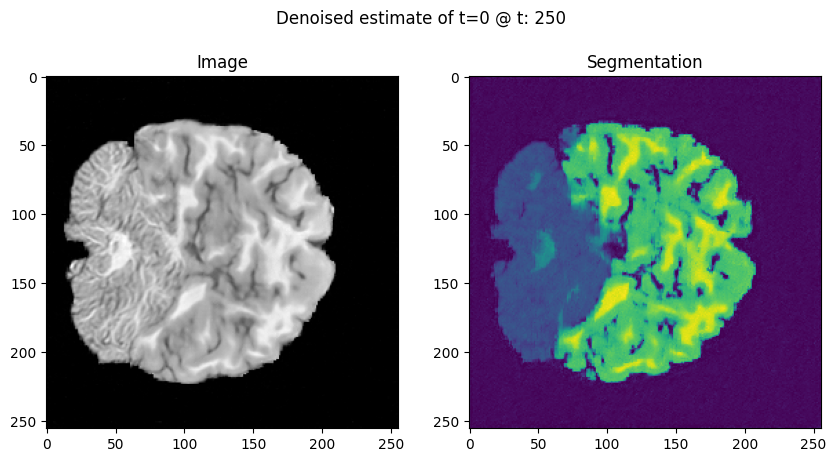

sampling loop time step:  44%|████▎     | 174/400 [02:37<03:47,  1.01s/it]

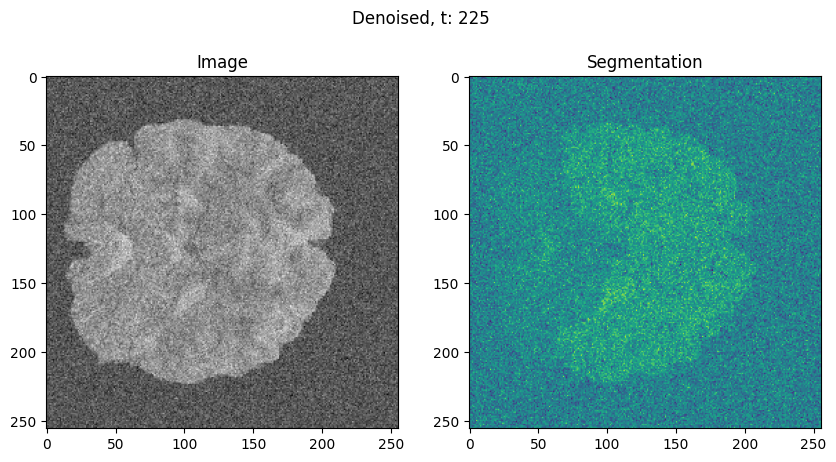

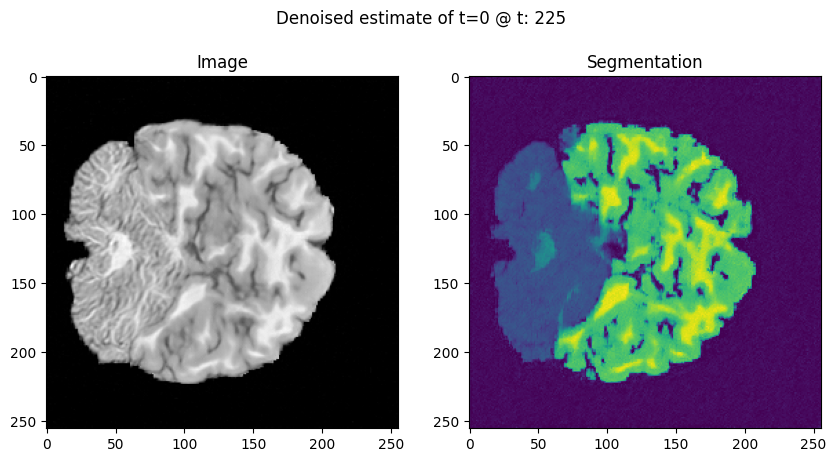

sampling loop time step:  50%|████▉     | 199/400 [02:58<03:13,  1.04it/s]

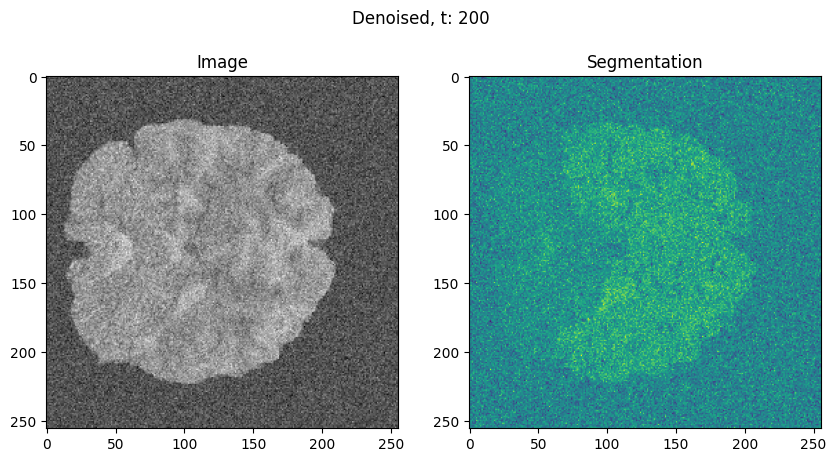

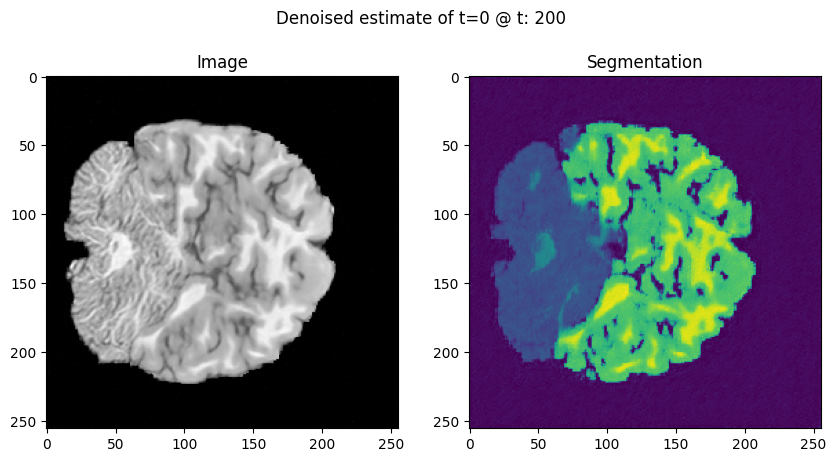

sampling loop time step:  56%|█████▌    | 224/400 [03:22<02:57,  1.01s/it]

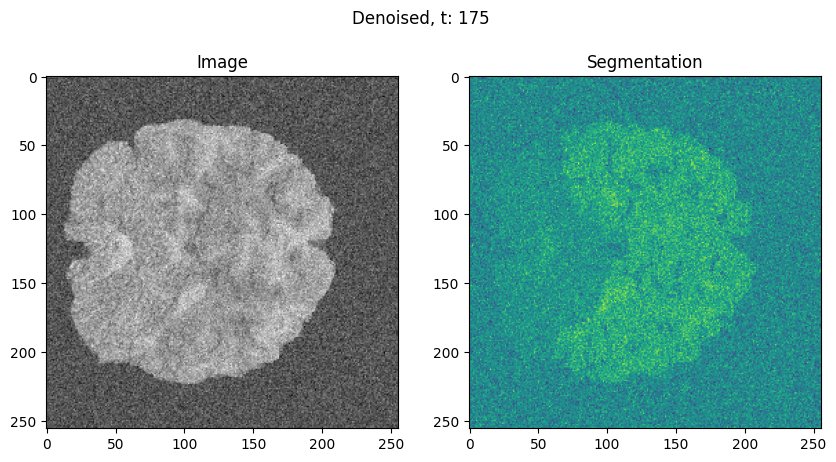

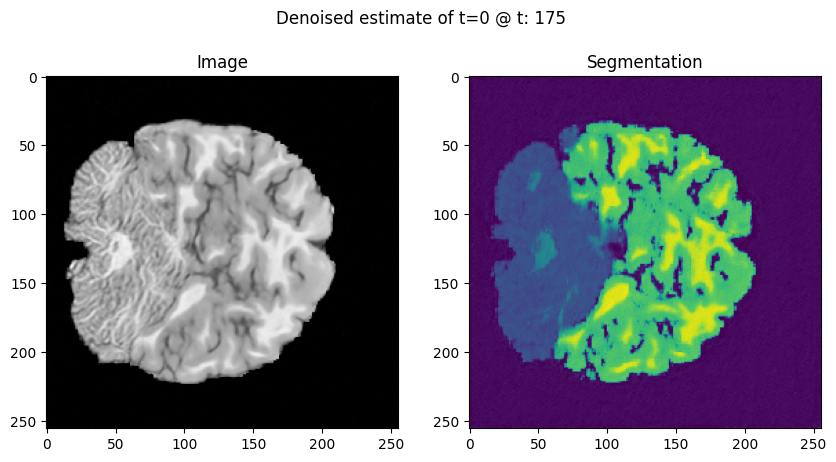

sampling loop time step:  62%|██████▏   | 249/400 [03:44<02:23,  1.05it/s]

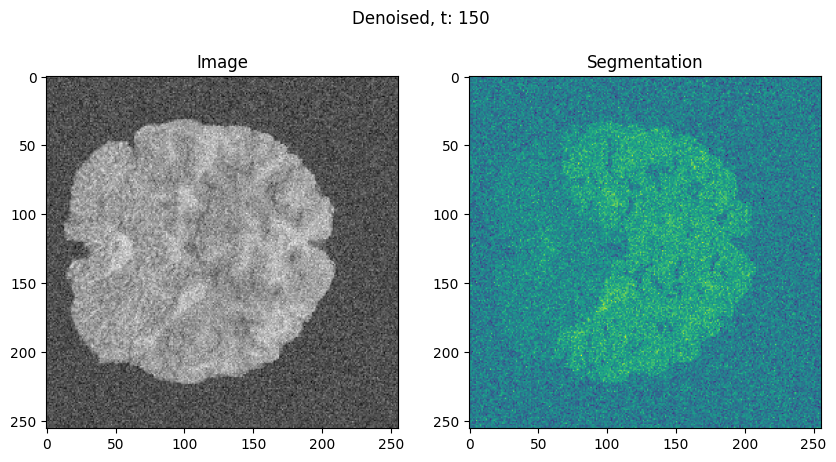

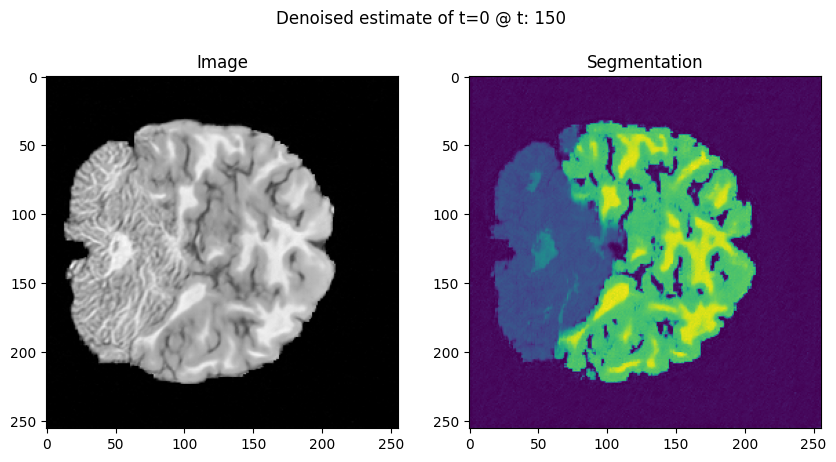

sampling loop time step:  67%|██████▋   | 267/400 [03:59<01:44,  1.27it/s]

sampling loop time step:  68%|██████▊   | 274/400 [04:06<01:45,  1.19it/s]

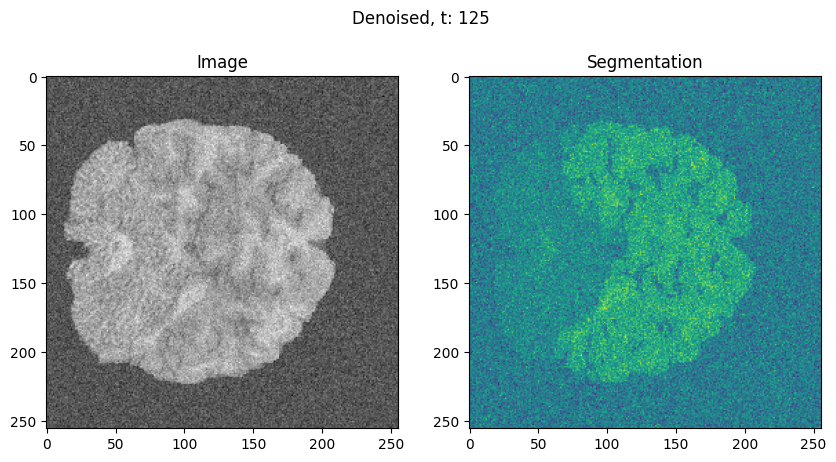

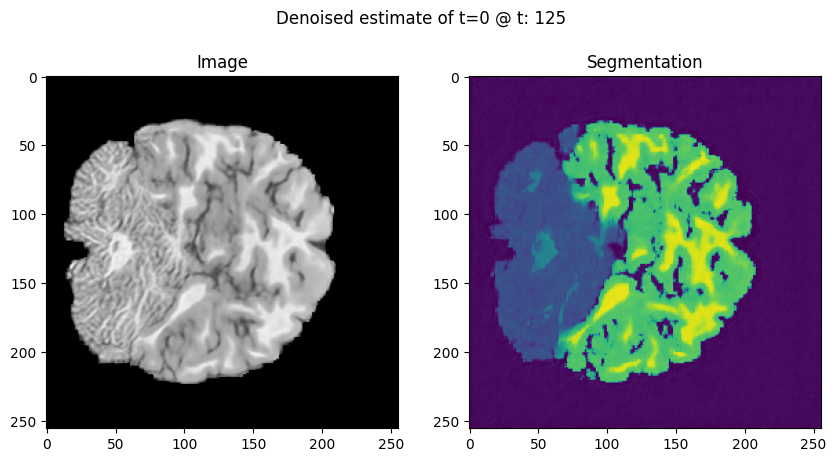

sampling loop time step:  75%|███████▍  | 299/400 [04:27<01:19,  1.27it/s]

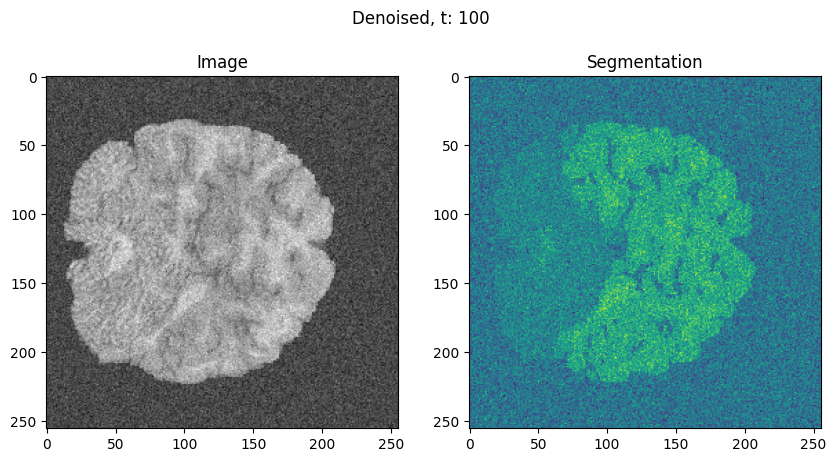

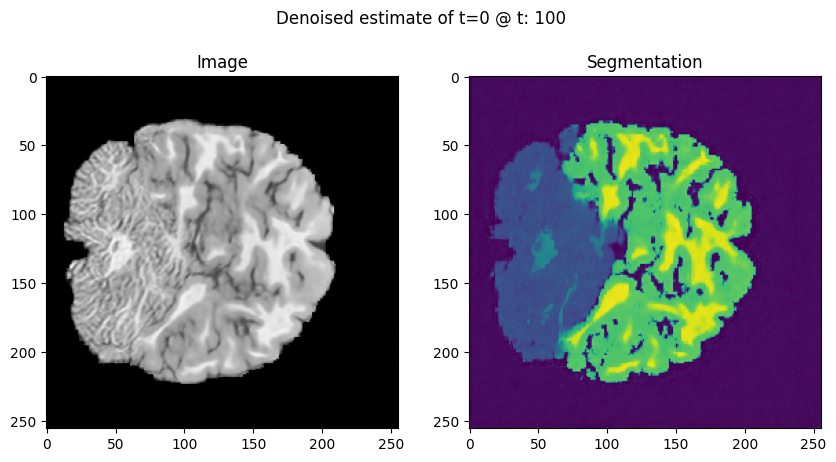

sampling loop time step:  81%|████████  | 324/400 [04:48<01:04,  1.18it/s]

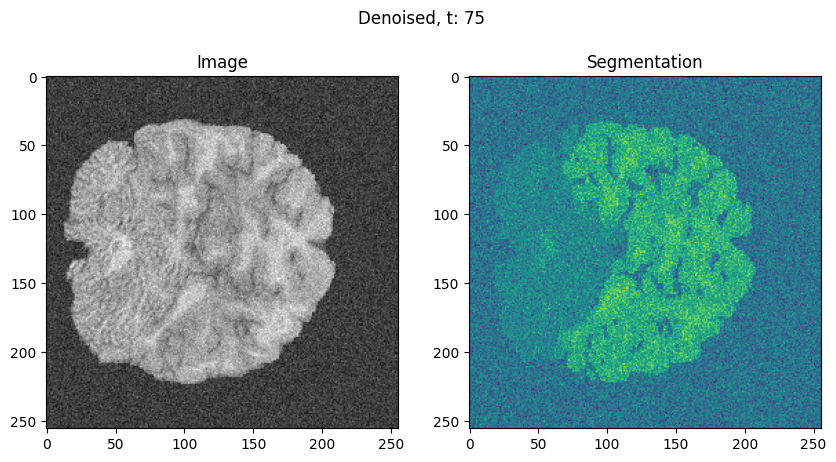

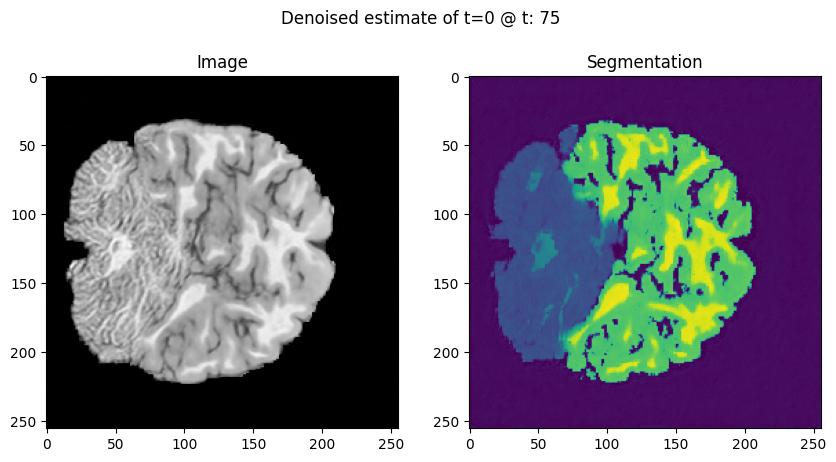

sampling loop time step:  87%|████████▋ | 349/400 [05:09<00:50,  1.00it/s]

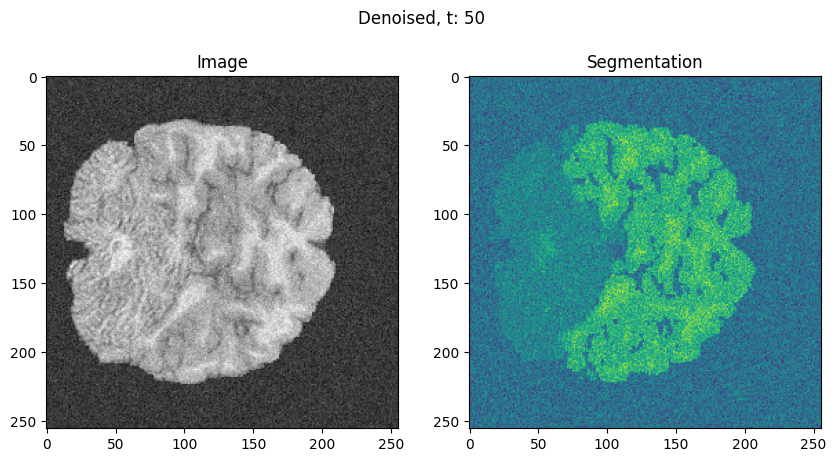

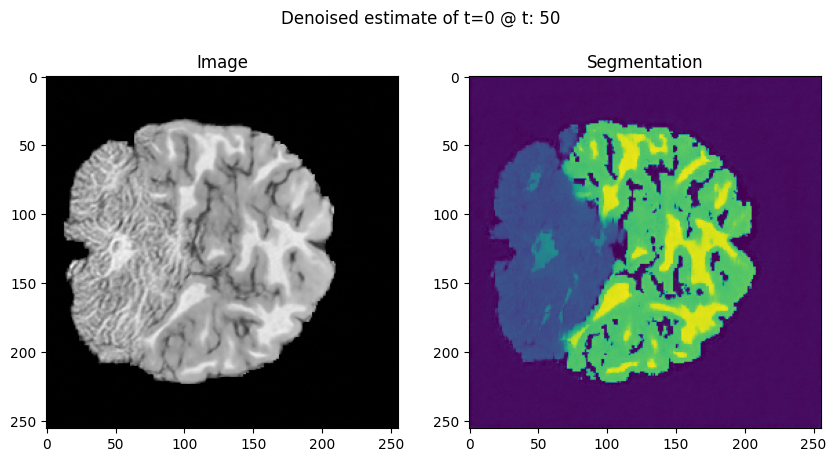

sampling loop time step:  94%|█████████▎| 374/400 [05:33<00:22,  1.15it/s]

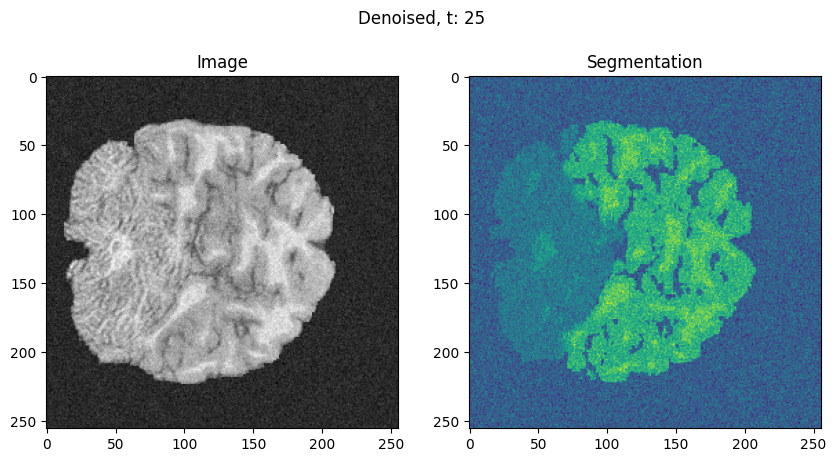

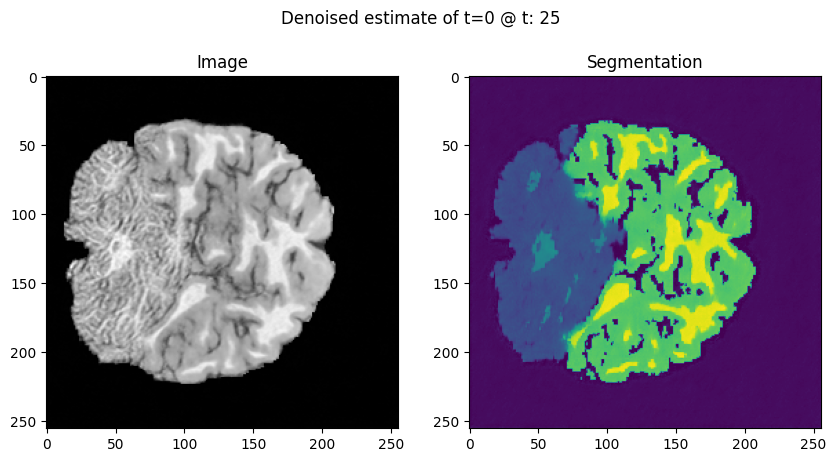

sampling loop time step: 100%|█████████▉| 399/400 [05:57<00:00,  1.12it/s]

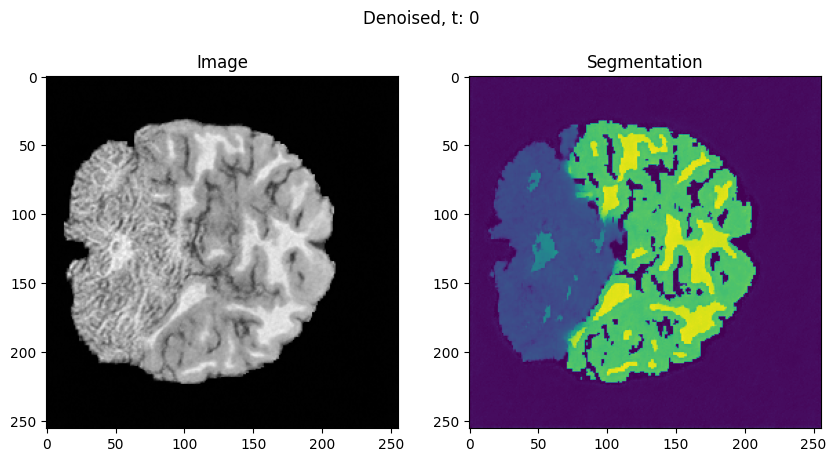

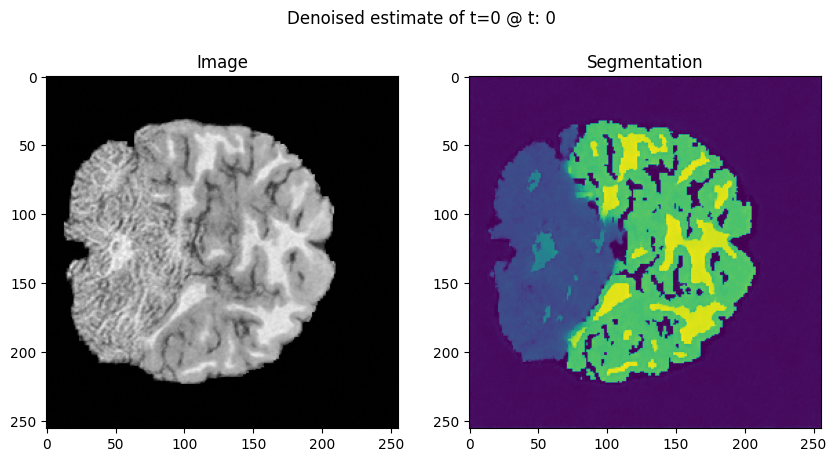

sampling loop time step: 100%|██████████| 400/400 [05:59<00:00,  1.11it/s]


In [55]:
img_metrics_td = evaluate_denoising(
    img=torch.from_numpy(rand_img_td),
    seg=torch.from_numpy(seg_td),
    n_classes=n_classes,
    t=400,
    ddpm=ddpm_ema.model,
    plot_every=25,
    metrics=metrics_to_log_default
    )

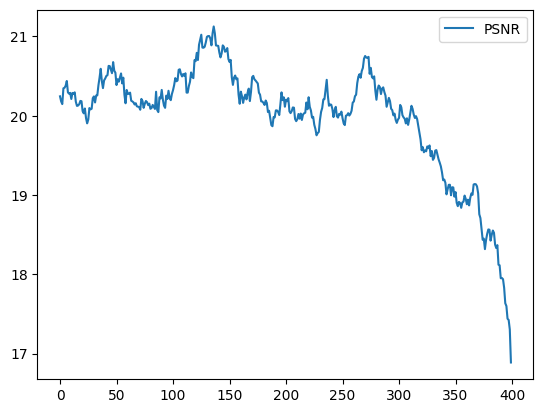

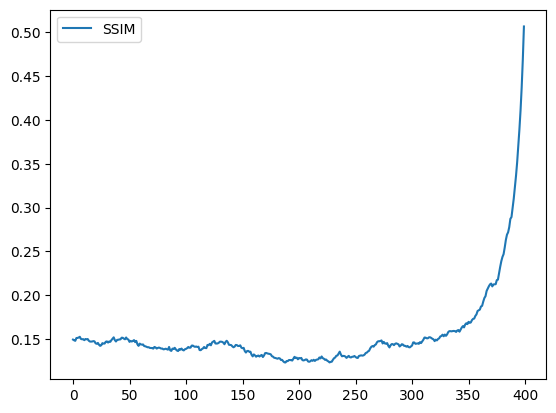

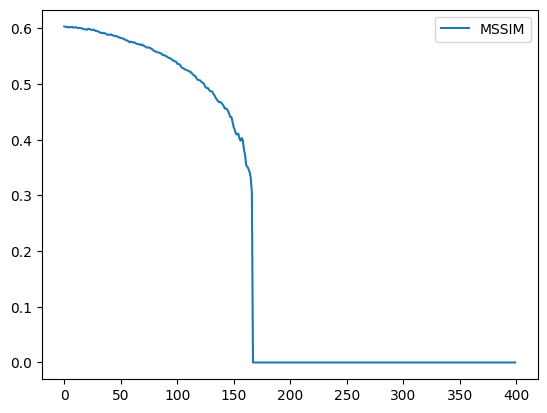

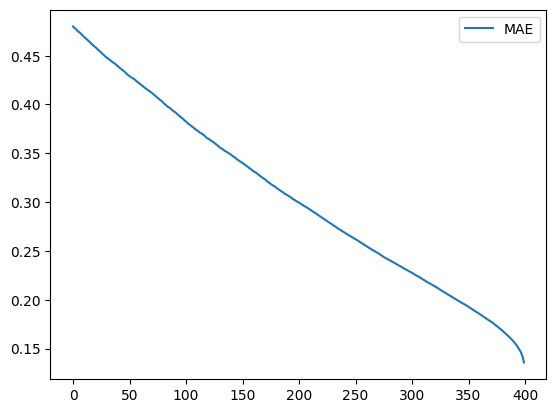

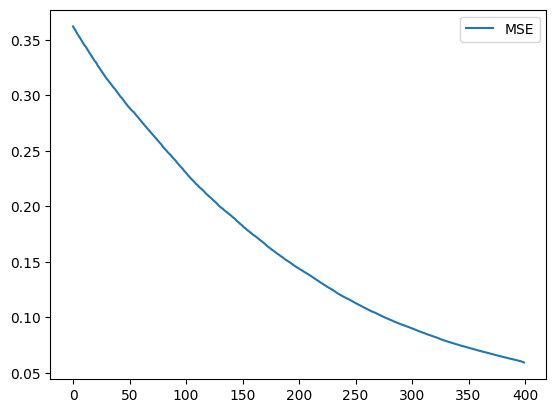

In [56]:
for metric_name, metric_log in img_metrics_td['img'].items():
    plt.plot(np.array(metric_log)[:, 1], label=metric_name)
    plt.legend()
    plt.show()

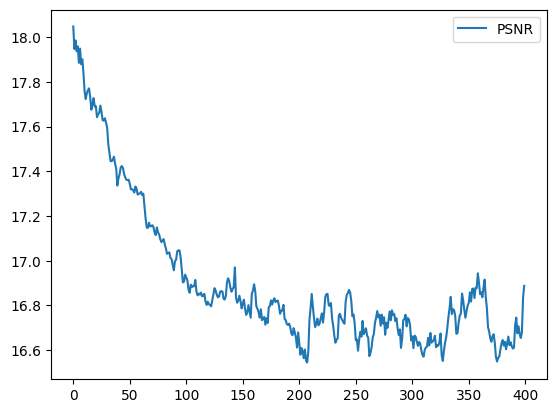

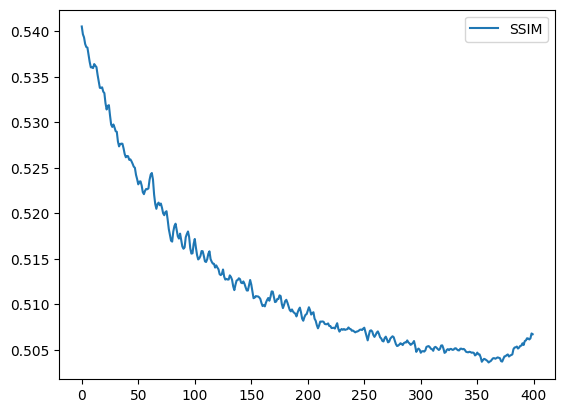

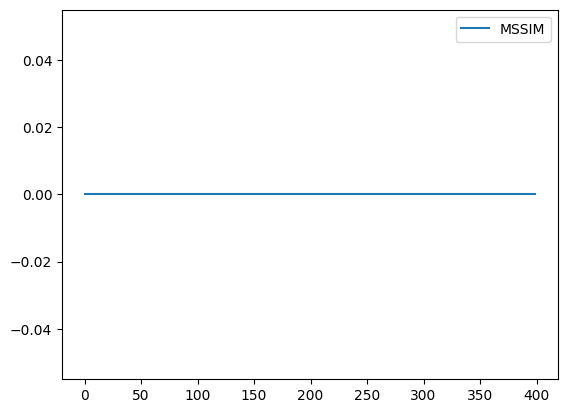

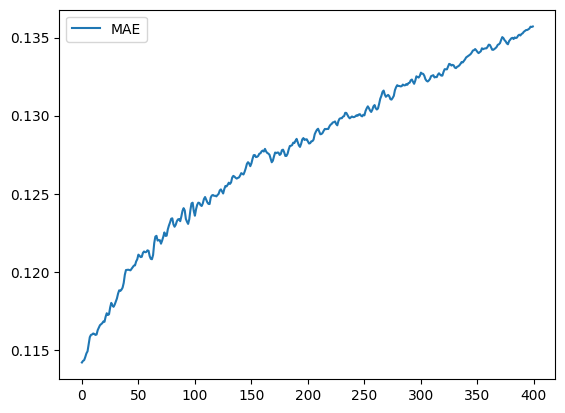

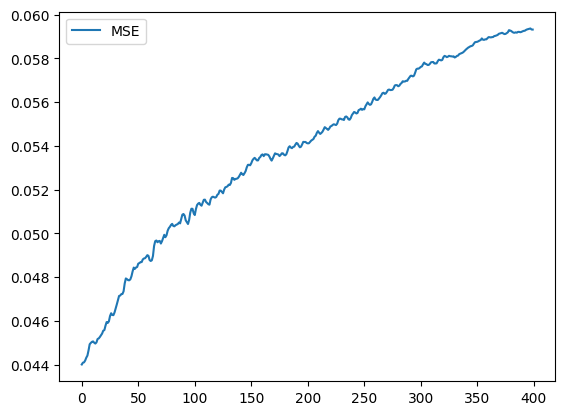

In [57]:
for metric_name, metric_log in img_metrics_td['img'].items():
    plt.plot(np.array(metric_log)[:, 2], label=metric_name)
    plt.legend()
    plt.show()